# Make full focal plane image with letter pattern 

(0.0, 4000.0)

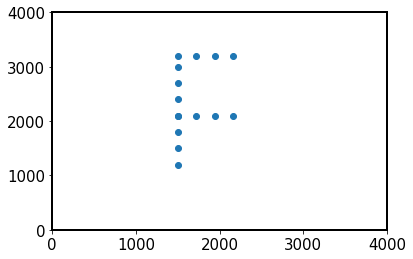

In [2]:
from lsst.ts.phosim.SkySim import SkySim
import numpy as np 
import os
from astropy.table import Table
from astropy.table import  hstack
from astropy.table import  vstack
import matplotlib.pyplot as plt

from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18

mjd = 57648  # arbitrary observation date 
raInDeg = 0 # telescope pointing in degrees 
declInDeg = 0
starMag = 15 # star magnitude 


def pixel_letter_F(xmin=500,ymin=200,width=800,height=1200,xspacing=220,yspacing=200):
    xmax = xmin+width
    ymax = ymin+height
    # initialize array storing coords for all pixels 
    xPx = np.zeros(0)
    yPx = np.zeros(0)

    # middle horizontal line
    x_mid = np.arange(xmin,xmax,xspacing)
    y_mid = np.ones_like(x_mid) * ((ymin+ymax)/2.)
    xPx = np.append(xPx, x_mid)
    yPx = np.append(yPx, y_mid)
    
    # top horizontal line
    x_top = x_mid.copy()
    y_top = np.ones_like(x_top)*ymax
    xPx = np.append(xPx, x_top)
    yPx = np.append(yPx, y_top)

    # vertical line
    y_vert = np.arange(ymin+200,ymax-100,yspacing)
    x_vert = np.ones_like(y_vert)*xmin
    xPx = np.append(xPx, x_vert)
    yPx = np.append(yPx, y_vert)

    return xPx, yPx

%matplotlib inline
x,y  = pixel_letter_F(xmin=1500,ymin=1000,yspacing=300, height=2200 )
plt.scatter(x,y)
plt.xlim(0,4000)
plt.ylim(0,4000)





Translate these into `ra,dec` with `SkySim`:

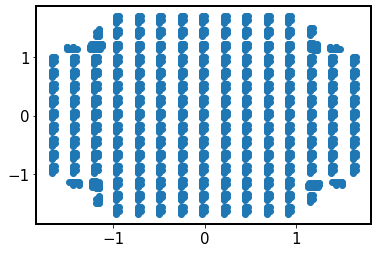

In [4]:
from lsst.obs.base import createInitialSkyWcsFromBoresight
from lsst.afw.cameraGeom import FOCAL_PLANE, PIXELS
import lsst.obs.lsst as obs_lsst
import lsst.geom

# Use the actual elements of SkySim and WcsSol , so 
# it's more transparent  how CCD coordinates get translated into Ra, Deg catalog 

mjd = 57648  # arbitrary observation date 
raInDeg = 0 # telescope pointing in degrees 
declInDeg = 0
starMag = 15 # star magnitude 
rotSkyPos=0
# get all sensors from the LsstCam : 
camera = obs_lsst.lsstCamMapper.LsstCamMapper().camera

#setObsMetaData in bsc/WcsSol.py 
boresightPointing = lsst.geom.SpherePoint(raInDeg, declInDeg, lsst.geom.degrees)
centerCcd= "R22_S11"
skyWcs = createInitialSkyWcsFromBoresight(
            boresightPointing,
            (90-rotSkyPos) * lsst.geom.degrees,
            camera[centerCcd],
            flipX=False,
        )



xInPixelInCam, yInPixelInCam  = pixel_letter_F(xmin=1500,ymin=1000,yspacing=300, height=2200 )



# sensorNameList = ["R22_S00", "R22_S01","R22_S02",
#               "R22_S10", "R22_S11","R22_S12",
#               "R22_S20", "R22_S21","R22_S22",
              
#               "R20_S00", "R20_S01", "R20_S02",
#               "R20_S10", "R20_S11", "R20_S12",
#               "R20_S20", "R20_S21", "R20_S22"
#              ] 

# get sensors from the camera
from lsst.obs.lsst import LsstCam
camera = LsstCam.getCamera()
sensorNameList = [sensor for sensor in camera.getNameMap()]


# parts of addStarByChipPos 

# Get the sky position in (ra, decl)
# raInDeg, declInDeg = self._getSkyPosByChipPos(
#     sensorName,
#     xInpixelInCam,
#     yInPixelInCam,
# )
# parts of _getSkyPosByChipPos 

# Get the pixel positions in DM team
# pixelDmX, pixelDmY = self._sourProc.camXY2DmXY(xInpixelInCam, yInPixelInCam)
# transpose - from DVCS to CCS 
pixelDmX, pixelDmY = yInPixelInCam,  xInPixelInCam


# Get the sky position in (ra, decl)
# raInDeg, declInDeg = self._wcsSol.raDecFromPixelCoords(
#     pixelDmX,
#     pixelDmY,
#     sensorName,
# )

raList = []
decList = []
xPxList = []
yPxList = []
centerChip = camera[centerCcd]
for sensorName in  sensorNameList:
    # same sensorName for each pixel in the list 
    chipNames =[sensorName for x in range(len(xInPixelInCam))]
    for chipX, chipY, ccdX, ccdY, chipName in zip(pixelDmX, 
                                                  pixelDmY, 
                                                  xInPixelInCam,
                                                  yInPixelInCam,
                                                  chipNames
                                                 ):
        #print(chipX,chipY,chipName, raPt,decPt)
        cameraChip = camera[chipName]
        # Get x,y on specified detector in terms of mm from center of cam
        camXyMm = cameraChip.transform(
            lsst.geom.Point2D(chipX, chipY), PIXELS, FOCAL_PLANE
        )
        # Convert mm to pixels
        camPoint = centerChip.transform(camXyMm, FOCAL_PLANE, PIXELS)

        # Calculate correct ra, dec
        raPt, decPt = skyWcs.pixelToSky(camPoint)

        raList.append(raPt.asDegrees())
        decList.append(decPt.asDegrees())
        xPxList.append(ccdX)
        yPxList.append(ccdY)

raInDeg, declInDeg =  np.array([raList, decList])
        
# Add the star
ra = raInDeg
dec = declInDeg
ra[ra>180] = ra[ra>180]-360
plt.scatter(ra,dec)

wrap that into a function:

In [129]:
from lsst.obs.base import createInitialSkyWcsFromBoresight
from lsst.afw.cameraGeom import FOCAL_PLANE, PIXELS
import lsst.obs.lsst as obs_lsst
import lsst.geom


def ccd_xy_to_radec(x_px=[0], y_px=[0], boresight_ra=0, boresight_dec=0, rotskypos=0,
                     sensorNameList = ['R22_S11']):
    # Use the actual elements of SkySim and WcsSol , so 
    # it's more transparent  how CCD coordinates get translated into Ra, Deg catalog 

    rotSkyPos=rotskypos
    # get all sensors from the LsstCam : 
    camera = obs_lsst.lsstCamMapper.LsstCamMapper().camera

    #setObsMetaData in bsc/WcsSol.py 
    boresightPointing = lsst.geom.SpherePoint(boresight_ra, 
                                              boresight_dec, 
                                              lsst.geom.degrees)
    centerCcd= "R22_S11"
    skyWcs = createInitialSkyWcsFromBoresight(
                boresightPointing,
                (90-rotSkyPos) * lsst.geom.degrees,
                camera[centerCcd],
                flipX=False,
            )

    # Get the pixel positions in DM team
    # pixelDmX, pixelDmY = self._sourProc.camXY2DmXY(xInpixelInCam, yInPixelInCam)
    # transpose - from DVCS to CCS 
    xInPixelInCam = x_px
    yInPixelInCam = y_px
    pixelDmX, pixelDmY = yInPixelInCam,  xInPixelInCam


    raList = []
    decList = []
    xPxList = []
    yPxList = []
    centerChip = camera[centerCcd]
    for sensorName in  sensorNameList:
        # same sensorName for each pixel in the list 
        chipNames =[sensorName for x in range(len(x_px))]
        for chipX, chipY, ccdX, ccdY, chipName in zip(pixelDmX, 
                                                      pixelDmY, 
                                                      xInPixelInCam,
                                                      yInPixelInCam,
                                                      chipNames
                                                     ):
            #print(chipX,chipY,chipName, raPt,decPt)
            cameraChip = camera[chipName]
            # Get x,y on specified detector in terms of mm from center of cam
            camXyMm = cameraChip.transform(
                lsst.geom.Point2D(chipX, chipY), PIXELS, FOCAL_PLANE
            )
            # Convert mm to pixels
            camPoint = centerChip.transform(camXyMm, FOCAL_PLANE, PIXELS)

            # Calculate correct ra, dec
            raPt, decPt = skyWcs.pixelToSky(camPoint)

            raList.append(raPt.asDegrees())
            decList.append(decPt.asDegrees())
            xPxList.append(ccdX)
            yPxList.append(ccdY)

    raInDeg, declInDeg =  np.array([raList, decList])
    
    return raInDeg, declInDeg , xPxList, yPxList

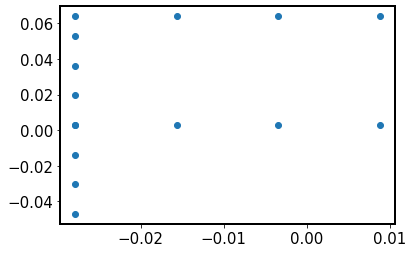

In [8]:
x_px, y_px  = pixel_letter_F(xmin=1500,ymin=1000,yspacing=300, height=2200 )

ra,dec,xPxList, yPxList = ccd_xy_to_radec(x_px=x_px, y_px=y_px, boresight_ra=0, boresight_dec=0, rotskypos=0,
                     sensorNameList = ['R22_S11'])
        
# Plot the star 
ra[ra>180] = ra[ra>180]-360
plt.scatter(ra,dec)

(-0.5, 0.5)

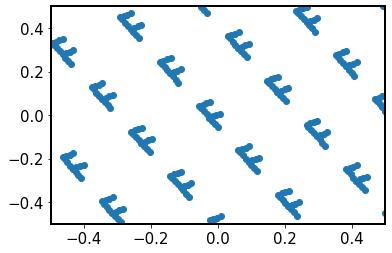

In [77]:
plt.scatter(ra,dec)
plt.xlim(-0.5,0.5)
plt.ylim(-0.5,0.5)

(-0.2, 0.8)

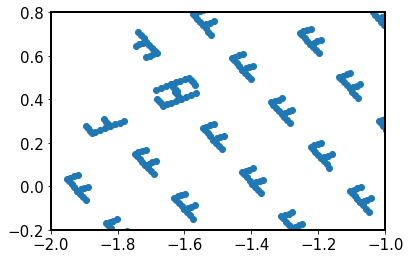

In [90]:
plt.scatter(ra,dec)
plt.xlim(-2,-1)
plt.ylim(-0.2,0.8)

(1.0, 2.0)

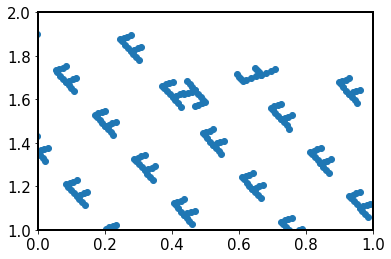

In [86]:
plt.scatter(ra,dec)
plt.xlim(0,1)
plt.ylim(1,2)

In [78]:
coords = Table(data=[ra, dec, xPxList, yPxList], 
             names=['ra','dec', 'xPx', 'yPx' ]  )

# add a column with object id 
coords['objid'] = np.arange(len(coords))
coords['g'] = [starMag for x in range(len(coords))]

In [145]:

# NB:  here we only do 0.25 sec exposure to quickly test if the image is properly made 
# in generating large catalogs, change to 15 sec. 
def writePhosimHeader(output, ra, dec, rotskypos=0, rottelpos=0, 
                      camconfig=3, Opsim_filter=3, mjd=59580., exposure=0.25,
                     obsid=9006002, defocal=False,
                     opsim_rawseeing=0.69):
    '''Write to file handle the phosim header'''
    output.write("Opsim_obshistid {}\n".format(obsid))
    output.write("Opsim_filter {}\n".format(Opsim_filter))
    output.write("mjd {}\n".format(mjd))
    output.write("SIM_SEED {}\n".format(1000))
    output.write("rightascension {}\n".format(ra))
    output.write("declination {}\n".format(dec))
    output.write("rotskypos {}\n".format(rotskypos))
    output.write("rottelpos {}\n".format(rottelpos))
    output.write("SIM_VISTIME {}\n".format(exposure))
    output.write("SIM_NSNAP {}\n".format(1))
    output.write("moonphase {}\n".format(0.0))
    output.write("moonalt {}\n".format(-90))
    output.write("sunalt {}\n".format(-90))
    output.write("Opsim_rawseeing {}\n".format(opsim_rawseeing))
    if defocal:
        output.write("move 10 -1500.0000\n") # write the defocal movement 
    output.write("camconfig {}\n".format(camconfig))

def writePhosimInstFile(catalog, ra, dec, rotskypos=0,  phosimFile="stars.inst", 
                        passband='r', outDir="./", camconfig=3, opd=False,
                        mjd=59580,exposure=.25, obsid=9006002, defocal=False,
                        constMag=15. ):
    '''Generate a phosim instance catalog from a Pandas dataframe or Astropy Table '''
    
    passbands = {"u":"umeanpsfmag", 
                 "g":"gmeanpsfmag", 
                 "r":"rmeanpsfmag", 
                 "i":"imeanpsfmag", 
                 "z":"zmeanpsfmag", 
                 "y":"ymeanpsfmag", 
                }
    
    outFile = os.path.join(outDir, phosimFile)
    
    filterID = list(passbands.keys()).index(passband)
    with open(outFile,'w') as output:
        writePhosimHeader(output, ra, dec, rotskypos=rotskypos, camconfig=camconfig, 
                          Opsim_filter=filterID, mjd=mjd,
                         exposure=exposure, obsid=obsid, defocal=defocal)
        if (opd==True):
            output.write("opd 0 {} {} 500".format(ra,dec))
        else:
            for idx in range(len(catalog)):
                row = catalog[idx]
                output.write("object {} {} {} {} ../sky/sed_flat.txt 0.0 0.0 0.0 0.0 0.0 0.0 star 12.0 none none\n".format(
                    int(row["objid"]),row["ra"],row["dec"], constMag))
    print('Saved as ', outFile)
    return outFile
 
    
# writePhosimInstFile(coords, ra=0, dec=0, rotskypos=0 , 
#                     phosimFile='lsstCam_entire_letterF_rot_30_.inst', 
#                     outDir='/project/scichris/aos/images/lsstCam/',
#                     passband='g', mjd=mjd, exposure=0.25, obsid=9006002, 
#                     defocal=True,constMag=starMag )

    # use original segmentation and focalplanelayout, i.e. without
    # any changes with Euler angle, serial direction, etc. 
    
    cd /project/scichris/aos/images/lsstCam/
    mkdir letter_lsstCam_entire_rot30
    mkdir letter_lsstCam_entire_rot30/raw/

    cd letter_lsstCam_entire_rot30

    python /project/scichris/aos/phosim_syseng4/phosim.py /project/scichris/aos/images/lsstCam/lsstCam_entire_letterF_rot_30_.inst -i lsst -e 1 -c /project/scichris/aos/images/lsstCam/noBkgnd.cmd -p 25 -o /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_rot30/raw/ > starPhoSimLetter.log 2>&1



    phosim_repackager.py /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_rot30/raw/ --out_dir /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_rot30/repackaged/ --inst lsst 


    cp ../letter_R22/runIsr.sh .
    cp ../letter_R22/testPipeline.yaml .

    ./runIsr.sh

Reading 0: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 0, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 65: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 65, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 123: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 123, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 188: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 188, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 189: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 189, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib

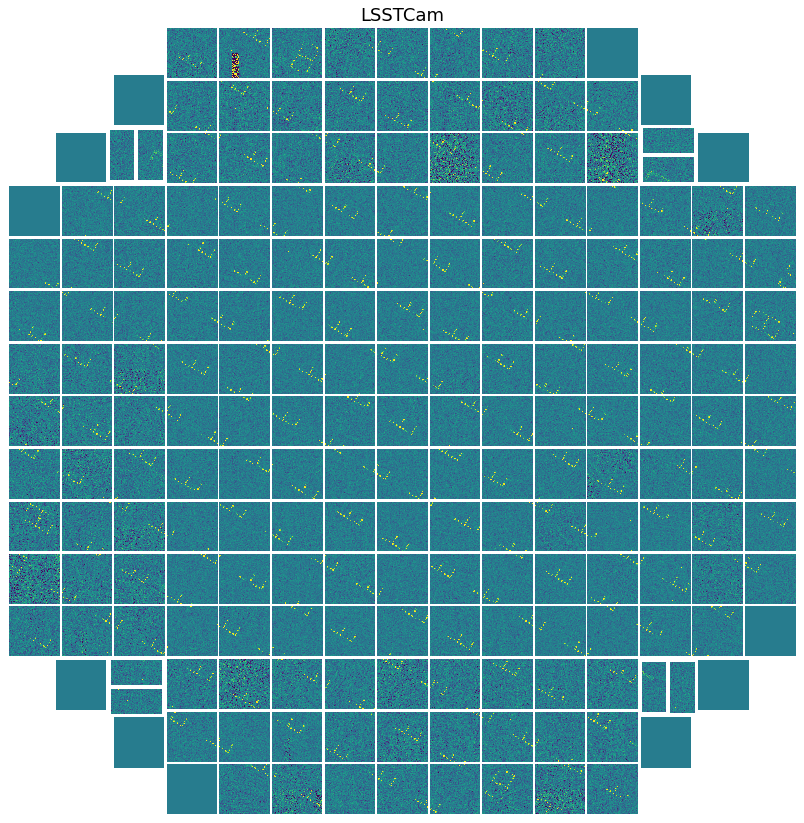

In [82]:
import os
# show the raw image 
from lsst.daf import butler as dafButler
import lsst.afw.cameraGeom.utils as cameraGeomUtils
import lsst.afw.display as afwDisplay

import matplotlib.pyplot as plt
from matplotlib import rcParams 
from astropy.io import fits
from astropy.visualization import ZScaleInterval

afwDisplay.setDefaultBackend("matplotlib")

repo_dir = os.path.join('/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_rot30/DATA/')

# need to specify the calib collections to be able to access the camera 
instrument = 'LSSTCam'
butler = dafButler.Butler(repo_dir, collections=[f'{instrument}/raw/all',
                                                 f'{instrument}/calib','run1',
                                                 f'{instrument}/calib/unbounded']
                         )

dataId0 = dict(instrument=instrument)
dataset = next(iter(
                    butler.registry.queryDatasets(
                        datasetType='postISRCCD', 
                        collections=['run1'],
                        dataId=dataId0  )
                    )
               )

exposure = dataset.dataId["exposure"]

camera  = butler.get("camera", instrument=instrument, exposure=exposure)

fig = plt.figure(figsize=(15,15))
fig.subplots_adjust(hspace=0., wspace=0.0, )

ax = fig.add_subplot(1, 1, 1)

disp = afwDisplay.Display(fig)
disp.scale('asinh', 'zscale', Q=2)
#disp.scale('linear', 'minmax')
#disp.scale('asinh', 5, 7000, Q=2)

disp.setImageColormap('viridis' if True else 'gray')
dataType = "postISRCCD"


# use that  to limit what's shown
#detectorNameList = ['R22_S11', 'R22_S20', 'R22_S10']# , 'R34_S20'] 

# set to None to plot everything
detectorNameList = None
mos = cameraGeomUtils.showCamera(camera,
                             cameraGeomUtils.ButlerImage(butler, dataType, 
                                                         instrument=instrument, 
                                                         exposure=exposure,
                                                         verbose=True),
                             binSize=16, 
                             detectorNameList=detectorNameList, 
                             display=disp, overlay=False, title=f'{instrument}' )
                             
disp.show_colorbar(False)
ax.axis("off")

plt.savefig('LsstCam_letter_entire_focal_plane_rot30_original.png', bbox_inches='tight')

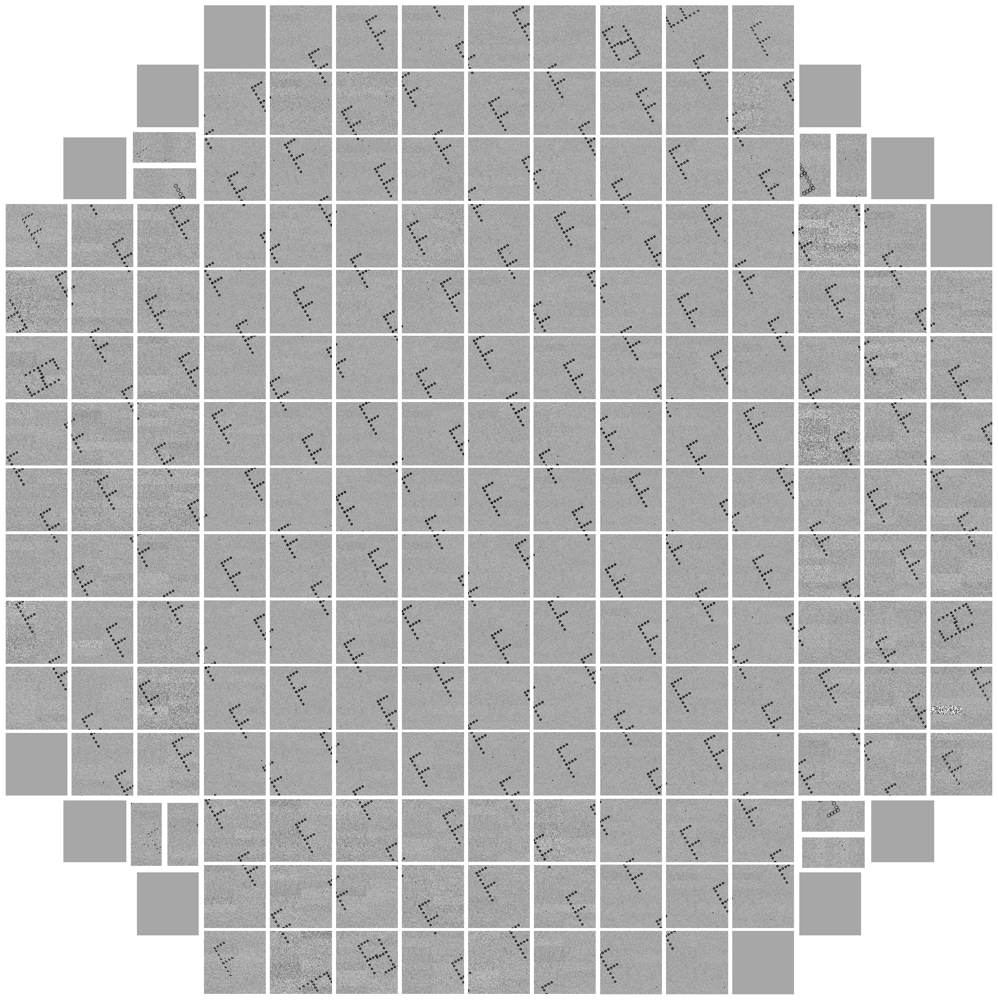

In [83]:
fig,ax = plt.subplots(1,1,figsize=(45,45))
zscale = ZScaleInterval()
vmin, vmax = zscale.get_limits(mos.array)
ax.imshow(mos.array.T, cmap='Greys', origin='lower', vmin=vmin,vmax=vmax)
ax.axis("off")
plt.savefig("LsstCam_letter_entire_focal_plane_rot30_original_hires.png",dpi=150)

Plot only few sensors to get an idea of the orientation:  

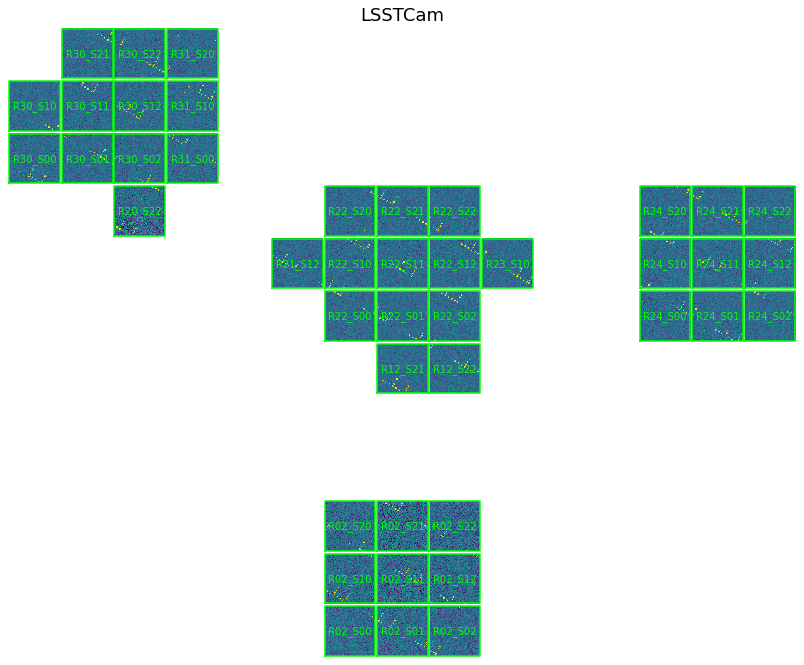

In [94]:
import os
# show the raw image 
from lsst.daf import butler as dafButler
import lsst.afw.cameraGeom.utils as cameraGeomUtils
import lsst.afw.display as afwDisplay

import matplotlib.pyplot as plt
from matplotlib import rcParams 
from astropy.io import fits
from astropy.visualization import ZScaleInterval

afwDisplay.setDefaultBackend("matplotlib")

repo_dir = os.path.join('/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_rot30/DATA/')

# need to specify the calib collections to be able to access the camera 
instrument = 'LSSTCam'
butler = dafButler.Butler(repo_dir, collections=[f'{instrument}/raw/all',
                                                 f'{instrument}/calib','run1',
                                                 f'{instrument}/calib/unbounded']
                         )

dataId0 = dict(instrument=instrument)
dataset = next(iter(
                    butler.registry.queryDatasets(
                        datasetType='postISRCCD', 
                        collections=['run1'],
                        dataId=dataId0  )
                    )
               )

exposure = dataset.dataId["exposure"]

camera  = butler.get("camera", instrument=instrument, exposure=exposure)

fig = plt.figure(figsize=(15,15))
fig.subplots_adjust(hspace=0., wspace=0.0, )

ax = fig.add_subplot(1, 1, 1)

disp = afwDisplay.Display(fig)
disp.scale('asinh', 'zscale', Q=2)
#disp.scale('linear', 'minmax')
#disp.scale('asinh', 5, 7000, Q=2)

disp.setImageColormap('viridis' if True else 'gray')
dataType = "postISRCCD"


# use that  to limit what's shown
#detectorNameList = ['R22_S11', 'R22_S20', 'R22_S10']# , 'R34_S20'] 

# set to None to plot everything
#detectorNameList = None
detectorNameList = ['R12_S21','R12_S22',
                    'R20_S22',
                    'R21_S12',
                    'R22_S20', 'R22_S21', 'R22_S22',
                    'R22_S10', 'R22_S11', 'R22_S12',
                    'R22_S00', 'R22_S01', 'R22_S02',
                    'R23_S10',
                               'R30_S21', 'R30_S22',
                    'R30_S10', 'R30_S11', 'R30_S12',
                    'R30_S00', 'R30_S01', 'R30_S02',
                    'R31_S00','R31_S10', 'R31_S20',
                    
                    'R02_S00', 'R02_S01', 'R02_S02',
                    'R02_S10', 'R02_S11', 'R02_S12',
                    'R02_S20', 'R02_S21', 'R02_S22',
                    
                    'R24_S00', 'R24_S01', 'R24_S02',
                    'R24_S10', 'R24_S11', 'R24_S12',
                    'R24_S20', 'R24_S21', 'R24_S22'
                   ]    

mos = cameraGeomUtils.showCamera(camera,
                             cameraGeomUtils.ButlerImage(butler, dataType, 
                                                         instrument=instrument, 
                                                         exposure=exposure,
                                                         verbose=True),
                             binSize=16, 
                             detectorNameList=detectorNameList, 
                             display=disp, overlay=True, title=f'{instrument}' )
                             
disp.show_colorbar(False)
ax.axis("off")

plt.savefig('LsstCam_letter_entire_focal_plane_rot30_original_select.png', bbox_inches='tight')

Make a pattern that stretches across multiple sensors: 

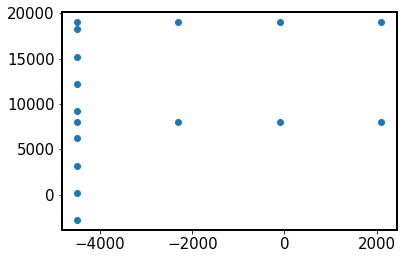

In [100]:
from lsst.ts.phosim.SkySim import SkySim
import numpy as np 
import os
from astropy.table import Table
from astropy.table import  hstack
from astropy.table import  vstack
import matplotlib.pyplot as plt

from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18

mjd = 57648  # arbitrary observation date 
raInDeg = 0 # telescope pointing in degrees 
declInDeg = 0
starMag = 15 # star magnitude 


def pixel_letter_F(xmin=500,ymin=200,width=800,height=1200,xspacing=220,yspacing=200):
    xmax = xmin+width
    ymax = ymin+height
    # initialize array storing coords for all pixels 
    xPx = np.zeros(0)
    yPx = np.zeros(0)

    # middle horizontal line
    x_mid = np.arange(xmin,xmax,xspacing)
    y_mid = np.ones_like(x_mid) * ((ymin+ymax)/2.)
    xPx = np.append(xPx, x_mid)
    yPx = np.append(yPx, y_mid)
    
    # top horizontal line
    x_top = x_mid.copy()
    y_top = np.ones_like(x_top)*ymax
    xPx = np.append(xPx, x_top)
    yPx = np.append(yPx, y_top)

    # vertical line
    y_vert = np.arange(ymin+200,ymax-100,yspacing)
    x_vert = np.ones_like(y_vert)*xmin
    xPx = np.append(xPx, x_vert)
    yPx = np.append(yPx, y_vert)

    return xPx, yPx

%matplotlib inline
f = 10 
x,y  = pixel_letter_F(xmin=-3*1500,ymin=-3*1000,xspacing=f*220, yspacing=f*300, width=f*800, height=f*2200 )
plt.scatter(x,y)




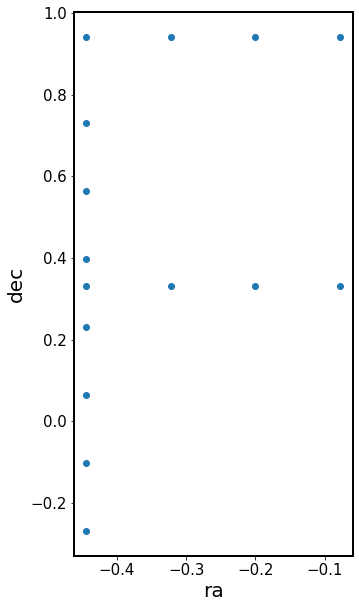

In [152]:
f=10
x_px, y_px  = pixel_letter_F(xmin=-4*1500,ymin=-3*1000,
                            xspacing=f*220, 
                            yspacing=f*300, 
                            width=f*800, 
                            height=f*2200 )
ra,dec, xPxList, yPxList = ccd_x_y_to_ra_dec(x_px=x_px, y_px=y_px, boresight_ra=0, boresight_dec=0, rotskypos=0,
                     sensorNameList = ['R22_S11']
                          )

# Plot the star 
ra[ra>180] = ra[ra>180]-360

fig,ax = plt.subplots(1,1,figsize=(5,10))
ax.scatter(ra,dec)
ax.set_xlabel('ra')
ax.set_ylabel('dec')
plt.savefig("LsstCam_input_catalog_large_F.jpeg", bbox_inches='tight')

In [141]:

dec

array([ 0.3306842 ,  0.3306879 ,  0.33069009,  0.33069077,  0.94170204,
        0.94171256,  0.94171879,  0.94172074, -0.26929822, -0.10263674,
        0.06402648,  0.23068861,  0.39734685,  0.56399835,  0.73064032])

x_px

In [147]:
# Add mag, objid

coords = Table(data=[ra, dec, xPxList, yPxList], 
             names=['ra','dec', 'xPx', 'yPx' ]  )

# add a column with object id 
coords['objid'] = np.arange(len(coords))
coords['g'] = [starMag for x in range(len(coords))]

writePhosimInstFile(coords, ra=0, dec=0, rotskypos=0 , 
                    phosimFile='R22_large_letterF.inst', 
                    outDir='/project/scichris/aos/images/lsstCam/',
                    passband='g', mjd=mjd, exposure=0.25, obsid=9006002, 
                    defocal=True,constMag=starMag )

Saved as  /project/scichris/aos/images/lsstCam/R22_large_letterF.inst


'/project/scichris/aos/images/lsstCam/R22_large_letterF.inst'

In [148]:
coords

ra,dec,xPx,yPx,objid,g
float64,float64,float64,float64,int64,int64
-0.4445188588117617,0.3306808203058149,-6000.0,8000.0,0,15
-0.32230215594938727,0.33068554048427706,-3800.0,8000.0,1,15
-0.20008252001036908,0.33068875612114074,-1600.0,8000.0,2,15
-0.0778610631825245,0.3306904670847461,600.0,8000.0,3,15
-0.4445188588117617,0.9416924090589739,-6000.0,19000.0,4,15
-0.32230215594938727,0.9417058487693685,-3800.0,19000.0,5,15
-0.20008252001036908,0.9417150046155726,-1600.0,19000.0,6,15
-0.0778610631825245,0.9417198762227359,600.0,19000.0,7,15
-0.4445188588117617,-0.26929546763652973,-6000.0,-2800.0,8,15


# Run quick simulation with that large letter 

    cd /project/scichris/aos/images/lsstCam/
    mkdir letter_R22_large
    mkdir letter_R22_large/raw/

    cd letter_R22_large

    python /project/scichris/aos/phosim_syseng4/phosim.py /project/scichris/aos/images/lsstCam/R22_large_letterF.inst -i lsst -e 1 -c /project/scichris/aos/images/lsstCam/noBkgnd.cmd -p 25 -o /project/scichris/aos/images/lsstCam/letter_R22_large/raw/ > starPhoSimLetter.log 2>&1


    phosim_repackager.py /project/scichris/aos/images/lsstCam/letter_R22_large/raw/ --out_dir /project/scichris/aos/images/lsstCam/letter_R22_large/repackaged/ --inst lsst 


    cp ../letter_R22/runIsr.sh .
    cp ../letter_R22/testPipeline.yaml .

    ./runIsr.sh


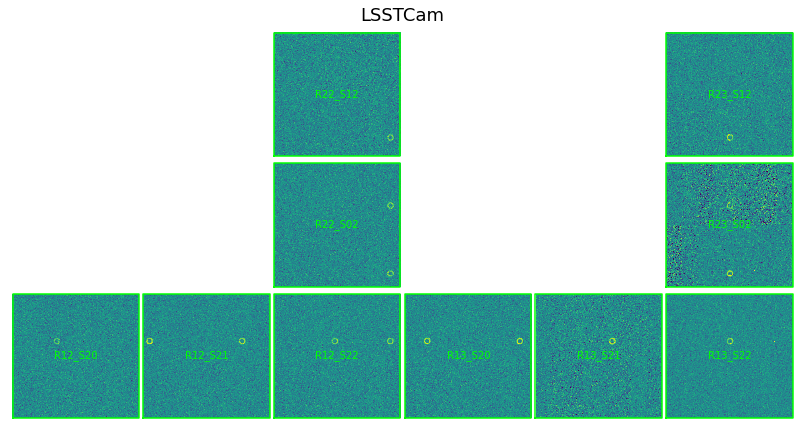

In [149]:
import os
# show the raw image 
from lsst.daf import butler as dafButler
import lsst.afw.cameraGeom.utils as cameraGeomUtils
import lsst.afw.display as afwDisplay

import matplotlib.pyplot as plt
from matplotlib import rcParams 
from astropy.io import fits
from astropy.visualization import ZScaleInterval

afwDisplay.setDefaultBackend("matplotlib")

repo_dir = os.path.join('/project/scichris/aos/images/lsstCam/letter_R22_large/DATA/')

# need to specify the calib collections to be able to access the camera 
instrument = 'LSSTCam'
butler = dafButler.Butler(repo_dir, collections=[f'{instrument}/raw/all',
                                                 f'{instrument}/calib','run1',
                                                 f'{instrument}/calib/unbounded']
                         )

dataId0 = dict(instrument=instrument)
dataset = next(iter(
                    butler.registry.queryDatasets(
                        datasetType='postISRCCD', 
                        collections=['run1'],
                        dataId=dataId0  )
                    )
               )

exposure = dataset.dataId["exposure"]

camera  = butler.get("camera", instrument=instrument, exposure=exposure)

fig = plt.figure(figsize=(15,15))
fig.subplots_adjust(hspace=0., wspace=0.0, )

ax = fig.add_subplot(1, 1, 1)

disp = afwDisplay.Display(fig)
disp.scale('asinh', 'zscale', Q=2)
#disp.scale('linear', 'minmax')
#disp.scale('asinh', 5, 7000, Q=2)

disp.setImageColormap('viridis' if True else 'gray')
dataType = "postISRCCD"


# use that  to limit what's shown
#detectorNameList = ['R22_S11', 'R22_S20', 'R22_S10']# , 'R34_S20'] 

# set to None to plot everything
#detectorNameList = None
detectorNameList = ['R12_S20', 'R12_S21', 'R12_S22', 
                    'R13_S20', 'R13_S21', 'R13_S22',
                    'R22_S02', 'R22_S12', 
                    'R23_S02','R23_S12'
                   ]    

mos = cameraGeomUtils.showCamera(camera,
                             cameraGeomUtils.ButlerImage(butler, dataType, 
                                                         instrument=instrument, 
                                                         exposure=exposure,
                                                         verbose=True),
                             binSize=16, 
                             detectorNameList=detectorNameList, 
                             display=disp, overlay=True, title=f'{instrument}' )
                             
disp.show_colorbar(False)
ax.axis("off")

plt.savefig('LsstCam_R22_large_letter.png', bbox_inches='tight')

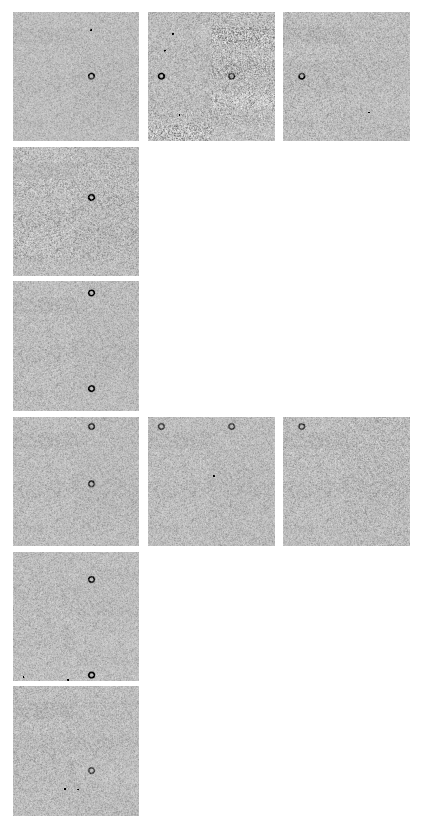

In [156]:
fig,ax = plt.subplots(1,1,figsize=(15,15))
zscale = ZScaleInterval()
vmin, vmax = zscale.get_limits(mos.array)
ax.imshow(np.rot90(mos.array), cmap='Greys', vmin=vmin,vmax=vmax)
ax.axis("off")
plt.savefig("LsstCam_R22_large_letter_rot90.jpeg")

Tile space with identical letters to test coverage:

In [58]:


# offset that letter by +/- N*dx,  from -30000 to +30000 px 
# this is because there are 7 ccds on each side of R22_S11 
# and each CCD is ~4072 px
# so  the edges of the FOX are about -30000 px to +30000 px 
# in R22_S11 CCD coords 

dx = 1000
dy = 2500
xHalfSpan = 30000
yHalfSpan = 30000


# get the center letter CCD coords 
x_px, y_px  = pixel_letter_F(xmin= 1500, ymin= 1000,
                            xspacing=220, 
                            yspacing=300, 
                            width=800, 
                            height=2200 )
# ra,dec, xPxList, yPxList = ccd_xy_to_radec(x_px=x_px, y_px=y_px, boresight_ra=0, boresight_dec=0, rotskypos=0,
#                      sensorNameList = ['R22_S11']
#                           )



# get the ra,dec applying shift to pixel coords. Since 
# the xHalfSpan, yHalfSpan is symmetric, 
# we also have xshift=0 and yshift=0, 
# so that the central letter is included as well 
raList = np.zeros(0)
decList = np.zeros(0)
xPxList = np.zeros(0)
yPxList = np.zeros(0)
for xshift in np.arange(-xHalfSpan, xHalfSpan, dx):
    for yshift in np.arange(-yHalfSpan, yHalfSpan, dy):
        #print(xshift, yshift)
        
        ra, dec, xPx, yPx = ccd_xy_to_radec(x_px=x_px+xshift, y_px=y_px+yshift, 
                                               boresight_ra=0, boresight_dec=0, 
                                               rotskypos=0, sensorNameList = ['R22_S11'])
        
        raList = np.append(raList, ra) #.append(ra)
        decList = np.append(decList,dec) #.append(dec)
        xPxList = np.append(xPxList,xPx)
        yPxList = np.append(yPxList,yPx)
        
        
        # just for plotting, need to shift from (0,360) to (-180,180) in ra 
        #

        #ax.scatter(ra,dec)
    


NameError: name 'pixel_letter_F' is not defined

In [53]:
#xPxList

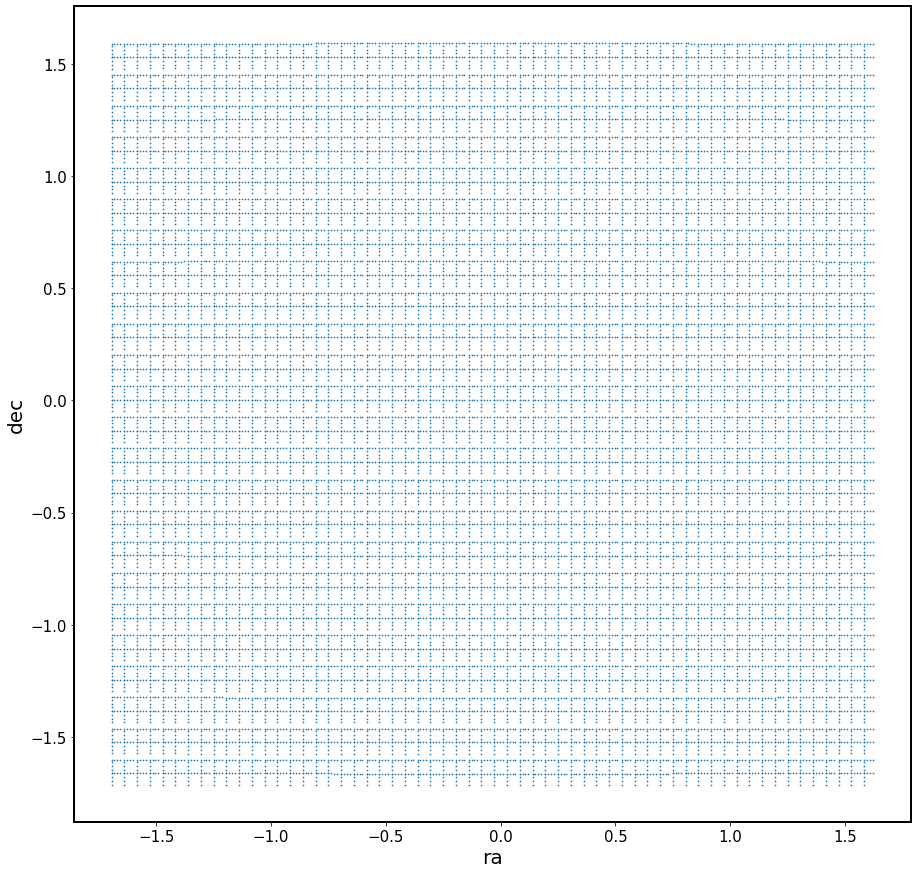

In [88]:
fig,ax = plt.subplots(1,1,figsize=(15,15))
raPlot = raList.copy()
raPlot[raPlot>180] = raPlot[raPlot>180]-360
ax.set_xlabel('ra')
ax.set_ylabel('dec')
ax.scatter(raPlot,decList,s=0.5)
plt.savefig('LsstCam_letter_entire_tiledF_input_catalog.jpeg', bbox_inches='tight')

store that as an inst catalog, submit to phoSim to simulate:

In [56]:
coords = Table(data=[raList, decList],  names=['ra','dec'])

# add a column with object id 
coords['objid'] = np.arange(len(coords))
#coords['g'] = [starMag for x in range(len(coords))]

starMag=15
writePhosimInstFile(coords, ra=0, dec=0, rotskypos=0 , 
                    phosimFile='lsstCam_entire_tiledF_.inst',  
                    outDir='/project/scichris/aos/images/lsstCam/',
                    passband='g', mjd=mjd, exposure=0.25, obsid=9006002, 
                    defocal=True, constMag=starMag )

Saved as  /project/scichris/aos/images/lsstCam/lsstCam_entire_tiledF_.inst


'/project/scichris/aos/images/lsstCam/lsstCam_entire_tiledF_.inst'

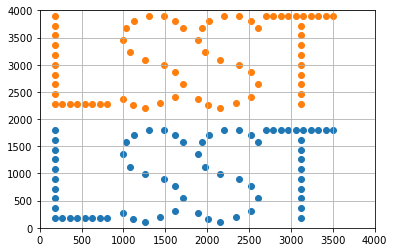

In [133]:
#Make LSST in lower-half of each raft 



def pixel_L(xmin=500,ymin=200,width=800,height=1200,xspacing=220,yspacing=200):
    xmax = xmin+width
    ymax = ymin+height
    
    # initialize array storing coords for all pixels 
    xPx = np.zeros(0)
    yPx = np.zeros(0)

    # bott horizontal line
    x_bot = np.arange(xmin,xmax,xspacing)
    y_bot = np.ones_like(x_bot)*ymin
    xPx = np.append(xPx, x_bot)
    yPx = np.append(yPx, y_bot)

    # vertical line
    y_vert = np.arange(ymin+200,ymax-100,yspacing)
    x_vert = np.ones_like(y_vert)*xmin
    xPx = np.append(xPx, x_vert)
    yPx = np.append(yPx, y_vert)

    return xPx, yPx

def pixel_S(x0=0,y0=0):
    xPx = np.array([1000,
                    900,
                    750,
                    550,
                    350,
                    250,
                    200,
                    300,
                    500,
                    750,
                    900,
                    1000,
                    900,
                   700,
                   500,
                   340,
                  205,
                   ]
                  )
    yPx = np.array([1750,
                   1900,
                   2000,
                   2000,
                   1900,
                   1750,
                   1500,
                   1250,
                   1100,
                   1000,
                   850,
                   600,
                   350,
                   215,
                   125,
                   185,
                   305,
                   ])
    xPx += x0
    return xPx, yPx



def pixel_T(xmin=500,ymin=200,width=800,height=1200,xspacing=220,yspacing=200):
    xmax = xmin+width
    ymax = ymin+height-200
    
    # initialize array storing coords for all pixels 
    xPx = np.zeros(0)
    yPx = np.zeros(0)

    # top horizontal line
    x_top = np.arange(xmin,xmax,xspacing)
    y_top = np.ones_like(x_top)*ymax
    xPx = np.append(xPx, x_top)
    yPx = np.append(yPx, y_top)

    # vertical line
    y_vert = np.arange(ymin,ymax,yspacing)
    x_vert = np.ones_like(y_vert)*((xmin+xmax)/2.)
    xPx = np.append(xPx, x_vert)
    yPx = np.append(yPx, y_vert)

    return xPx, yPx

%matplotlib inline

# x,y  = pixel_L(xmin=200,ymin=200,xspacing=100, yspacing=200, width=800, height=2000 )
# plt.scatter(x,y)

# x,y = pixel_S(x0=900)
# plt.scatter(x,y)

# x,y = pixel_S(x0=1900)
# plt.scatter(x,y)

# x,y = pixel_T(xmin=3000,ymin=200,xspacing=100, yspacing=200, width=950, height=2000)
# plt.scatter(x,y)

def pixel_LSST(x0=0,y0=0,xf=1.0,yf=1.0):
    
    xPx = np.zeros(0)
    yPx = np.zeros(0)
    
    x,y = pixel_L(xmin=200,ymin=200,xspacing=100, yspacing=200, width=800, height=2000 )
    xPx = np.append(xPx, x)
    yPx = np.append(yPx, y)
    
    x,y = pixel_S(x0=900)
    xPx = np.append(xPx, x)
    yPx = np.append(yPx, y)
    
    x,y = pixel_S(x0=1900)
    xPx = np.append(xPx, x)
    yPx = np.append(yPx, y)
    
    x,y = pixel_T(xmin=3000,ymin=200,xspacing=100, yspacing=200, width=950, height=2000)
    xPx = np.append(xPx, x)
    yPx = np.append(yPx, y)
    
    
    xPx *= xf
    yPx *= yf 
    
    xPx += x0
    yPx += y0 
    
    
    
    return xPx, yPx 
    
xPx = np.zeros(0)
yPx = np.zeros(0)
    
x,y = pixel_LSST(xf=0.9, yf=0.9)
xPx = np.append(xPx, x)
yPx = np.append(yPx, y)
plt.scatter(x,y)

x,y = pixel_LSST(xf=0.9, yf=0.9, y0=2100)
xPx = np.append(xPx, x)
yPx = np.append(yPx, y)
plt.scatter(x,y)

plt.xlim(0,4000)
plt.ylim(0,4000)
plt.grid()

In [134]:
xPx_start  = xPx.copy()
yPx_start = yPx.copy()

In [144]:
# offset that letter by +/- N*dx,  from -30000 to +30000 px 
# this is because there are 7 ccds on each side of R22_S11 
# and each CCD is ~4072 px
# so  the edges of the FOX are about -30000 px to +30000 px 
# in R22_S11 CCD coords 

dx = 4000
dy = 4000
xHalfSpan = 35000
yHalfSpan = 35000

# get the ra,dec applying shift to pixel coords. Since 
# the xHalfSpan, yHalfSpan is symmetric, 
# we also have xshift=0 and yshift=0, 
# so that the central letter is included as well 
raList = np.zeros(0)
decList = np.zeros(0)
xPxList = np.zeros(0)
yPxList = np.zeros(0)
for xshift in np.arange(-xHalfSpan, xHalfSpan, dx):
    for yshift in np.arange(-yHalfSpan, yHalfSpan, dy):
        #print(xshift, yshift)
        
        ra, dec, xPx, yPx = ccd_xy_to_radec(x_px=xPx_start+xshift, y_px=yPx_start+yshift, 
                                               boresight_ra=0, boresight_dec=0, 
                                               rotskypos=0, sensorNameList = ['R22_S11'])
        
        raList = np.append(raList, ra) #.append(ra)
        decList = np.append(decList,dec) #.append(dec)
        xPxList = np.append(xPxList,xPx)
        yPxList = np.append(yPxList,yPx)
    

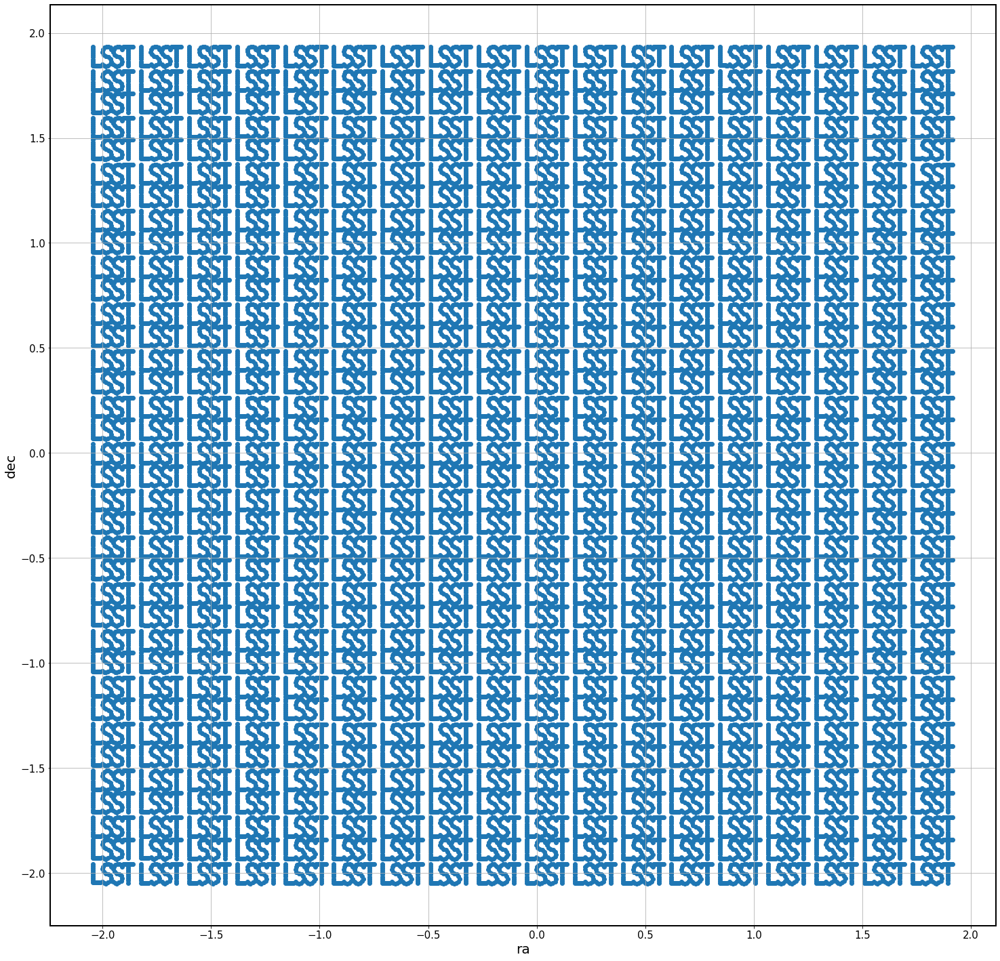

In [147]:
import matplotlib.pyplot as plt

from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18


# Plot the star 
ra = raList.copy()
ra[ra>180] = ra[ra>180]-360

fig,ax = plt.subplots(1,1,figsize=(25,25))
ax.scatter(ra,decList)
ax.set_xlabel('ra')
ax.set_ylabel('dec')
ax.grid()
plt.savefig("LsstCam_input_catalog_large_LSST.jpeg", bbox_inches='tight')

In [150]:
from astropy.table import Table

# make an inst catalog 
coords = Table(data=[raList, decList],  names=['ra','dec'])

# add a column with object id 
coords['objid'] = np.arange(len(coords))
#coords['g'] = [starMag for x in range(len(coords))]

starMag=14
mjd = 57648  # arbitrary observation date 
writePhosimInstFile(coords, ra=0, dec=0, rotskypos=0 , 
             m       phosimFile='lsstCam_entire_tiled_LSST.inst',  
                    outDir='/project/scichris/aos/images/lsstCam/',
                    passband='g', mjd=mjd, exposure=0.25, obsid=9006002, 
                    defocal=False, constMag=starMag )

Saved as  /project/scichris/aos/images/lsstCam/lsstCam_entire_tiled_LSST.inst


'/project/scichris/aos/images/lsstCam/lsstCam_entire_tiled_LSST.inst'


use original segmentation and focalplanelayout, i.e. without any changes with Euler angle, serial direction, etc. 
    
    cd /project/scichris/aos/images/lsstCam/
    mkdir letter_lsstCam_entire_tiledF
    mkdir letter_lsstCam_entire_tiledF/raw/

    cd letter_lsstCam_entire_tiledF

    python /project/scichris/aos/phosim_syseng4/phosim.py /project/scichris/aos/images/lsstCam/lsstCam_entire_tiledF_.inst -i lsst -e 1 -c /project/scichris/aos/images/lsstCam/noBkgnd.cmd -p 25 -o /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF/raw/ > starPhoSimLetter.log 2>&1



    phosim_repackager.py /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF/raw/ --out_dir /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF/repackaged/ --inst lsst 


    cp ../letter_R22/runIsr.sh .
    cp ../letter_R22/testPipeline.yaml .

    ./runIsr.sh               

Reading 189: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 189, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 190: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 190, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 193: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 193, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 194: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 194, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 197: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 197, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam

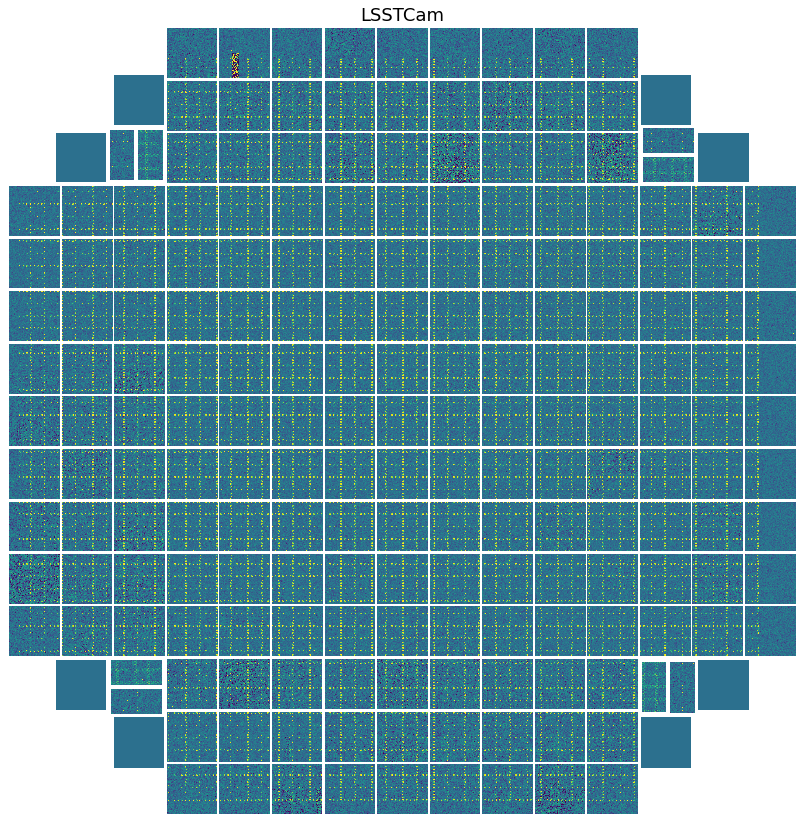

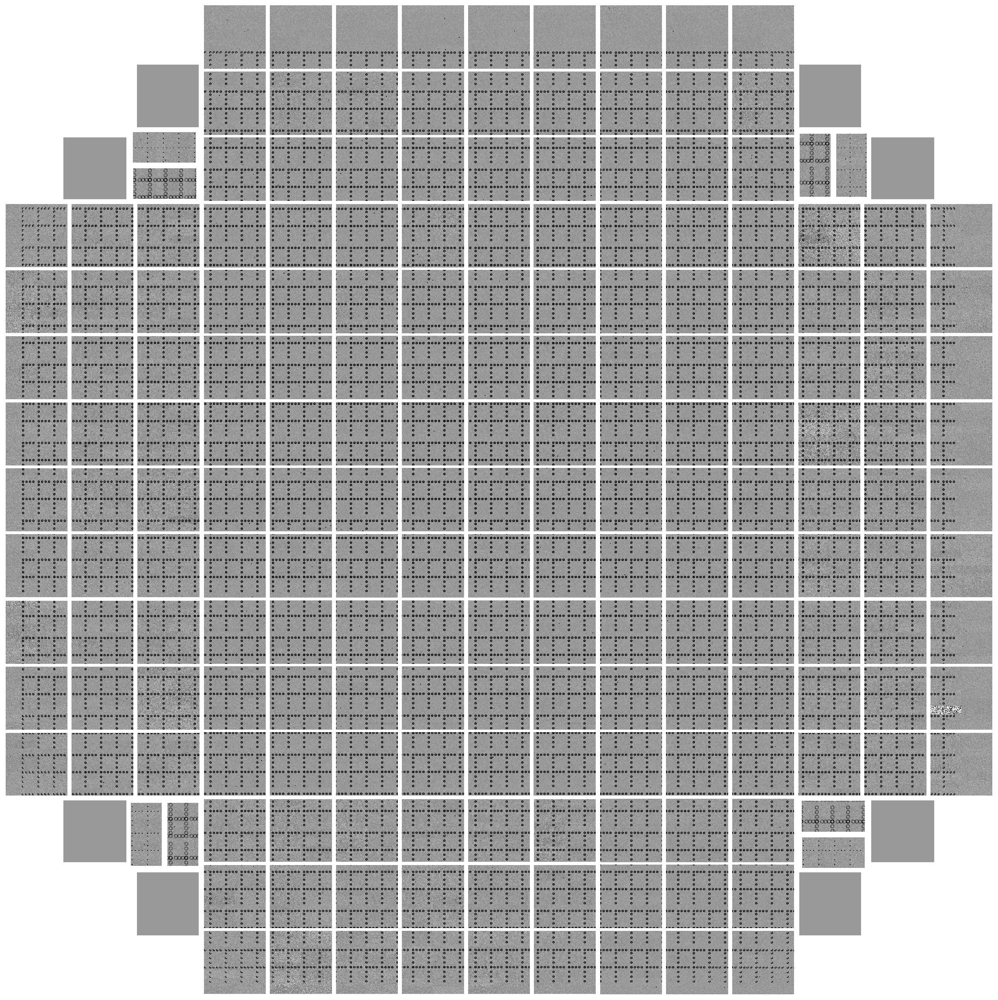

In [57]:
import os
# show the raw image 
from lsst.daf import butler as dafButler
import lsst.afw.cameraGeom.utils as cameraGeomUtils
import lsst.afw.display as afwDisplay

import matplotlib.pyplot as plt
from matplotlib import rcParams 
from astropy.io import fits
from astropy.visualization import ZScaleInterval

afwDisplay.setDefaultBackend("matplotlib")

repo_dir = os.path.join('/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF/DATA/')

# need to specify the calib collections to be able to access the camera 
instrument = 'LSSTCam'
butler = dafButler.Butler(repo_dir, collections=[f'{instrument}/raw/all',
                                                 f'{instrument}/calib','run1',
                                                 f'{instrument}/calib/unbounded']
                         )

dataId0 = dict(instrument=instrument)
dataset = next(iter(
                    butler.registry.queryDatasets(
                        datasetType='postISRCCD', 
                        collections=['run1'],
                        dataId=dataId0  )
                    )
               )

exposure = dataset.dataId["exposure"]

camera  = butler.get("camera", instrument=instrument, exposure=exposure)

fig = plt.figure(figsize=(15,15))
fig.subplots_adjust(hspace=0., wspace=0.0, )

ax = fig.add_subplot(1, 1, 1)

disp = afwDisplay.Display(fig)
disp.scale('asinh', 'zscale', Q=2)
#disp.scale('linear', 'minmax')
#disp.scale('asinh', 5, 7000, Q=2)

disp.setImageColormap('viridis' if True else 'gray')
dataType = "postISRCCD"


# use that  to limit what's shown
#detectorNameList = ['R22_S11', 'R22_S20', 'R22_S10']# , 'R34_S20'] 

# set to None to plot everything
detectorNameList = None
mos = cameraGeomUtils.showCamera(camera,
                             cameraGeomUtils.ButlerImage(butler, dataType, 
                                                         instrument=instrument, 
                                                         exposure=exposure,
                                                         verbose=True),
                             binSize=16, 
                             detectorNameList=detectorNameList, 
                             display=disp, overlay=False, title=f'{instrument}' )
                             
disp.show_colorbar(False)
ax.axis("off")

plt.savefig('LsstCam_letter_entire_tiledF.png', bbox_inches='tight')

fig,ax = plt.subplots(1,1,figsize=(45,45))
zscale = ZScaleInterval()
vmin, vmax = zscale.get_limits(mos.array)
ax.imshow(mos.array.T,  origin='lower', cmap='Greys', vmin=vmin,vmax=vmax)
ax.axis("off")
plt.savefig("LsstCam_letter_entire_tiledF_hires.png",dpi=150)

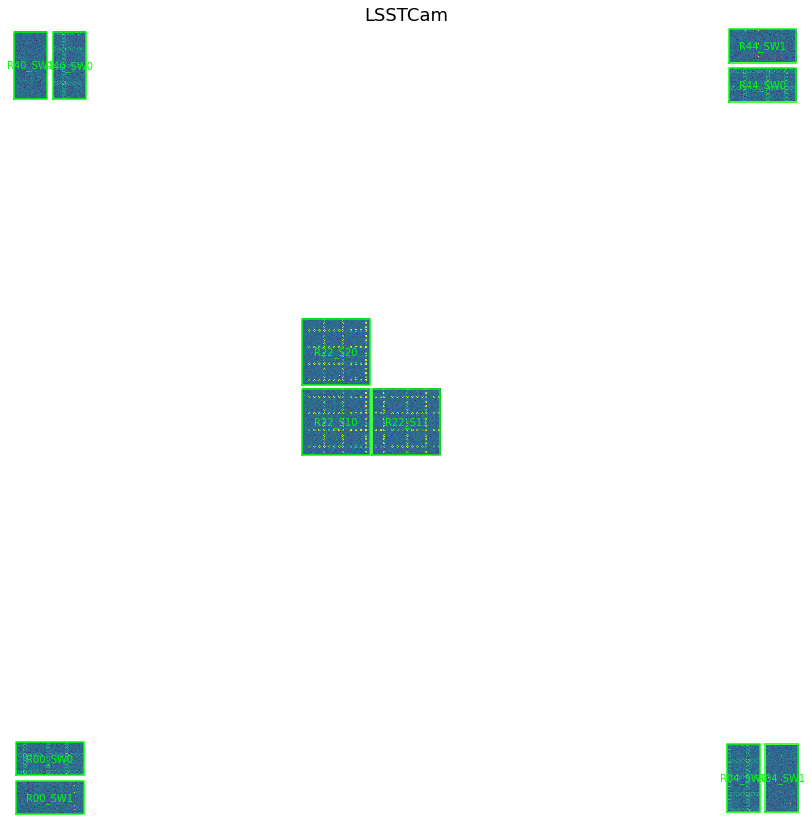

In [68]:
import os
# show the raw image 
from lsst.daf import butler as dafButler
import lsst.afw.cameraGeom.utils as cameraGeomUtils
import lsst.afw.display as afwDisplay

import matplotlib.pyplot as plt
from matplotlib import rcParams 
from astropy.io import fits
from astropy.visualization import ZScaleInterval

afwDisplay.setDefaultBackend("matplotlib")

repo_dir = os.path.join('/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF/DATA/')

# need to specify the calib collections to be able to access the camera 
instrument = 'LSSTCam'
butler = dafButler.Butler(repo_dir, collections=[f'{instrument}/raw/all',
                                                 f'{instrument}/calib','run1',
                                                 f'{instrument}/calib/unbounded']
                         )

dataId0 = dict(instrument=instrument)
dataset = next(iter(
                    butler.registry.queryDatasets(
                        datasetType='postISRCCD', 
                        collections=['run1'],
                        dataId=dataId0  )
                    )
               )

exposure = dataset.dataId["exposure"]

camera  = butler.get("camera", instrument=instrument, exposure=exposure)

fig = plt.figure(figsize=(15,15))
fig.subplots_adjust(hspace=0., wspace=0.0, )

ax = fig.add_subplot(1, 1, 1)

disp = afwDisplay.Display(fig)
disp.scale('asinh', 'zscale', Q=2)
#disp.scale('linear', 'minmax')
#disp.scale('asinh', 5, 7000, Q=2)

disp.setImageColormap('viridis' if True else 'gray')
dataType = "postISRCCD"


# use that  to limit what's shown
#detectorNameList = ['R22_S11', 'R22_S20', 'R22_S10']# , 'R34_S20'] 

# set to None to plot everything
detectorNameList = [ "R04_SW0", "R04_SW1",
                     "R44_SW0", "R44_SW1",
                     "R00_SW0", "R00_SW1",
                     "R40_SW0", "R40_SW1",
                    'R22_S11', 'R22_S20', 'R22_S10'
                   ] 
mos = cameraGeomUtils.showCamera(camera,
                             cameraGeomUtils.ButlerImage(butler, dataType, 
                                                         instrument=instrument, 
                                                         exposure=exposure,
                                                         verbose=True),
                             binSize=16, 
                             detectorNameList=detectorNameList, 
                             display=disp, overlay=True, title=f'{instrument}' )
                             
disp.show_colorbar(False)
ax.axis("off")

plt.savefig('LsstCam_letter_entire_tiledF_wfs.png', bbox_inches='tight')




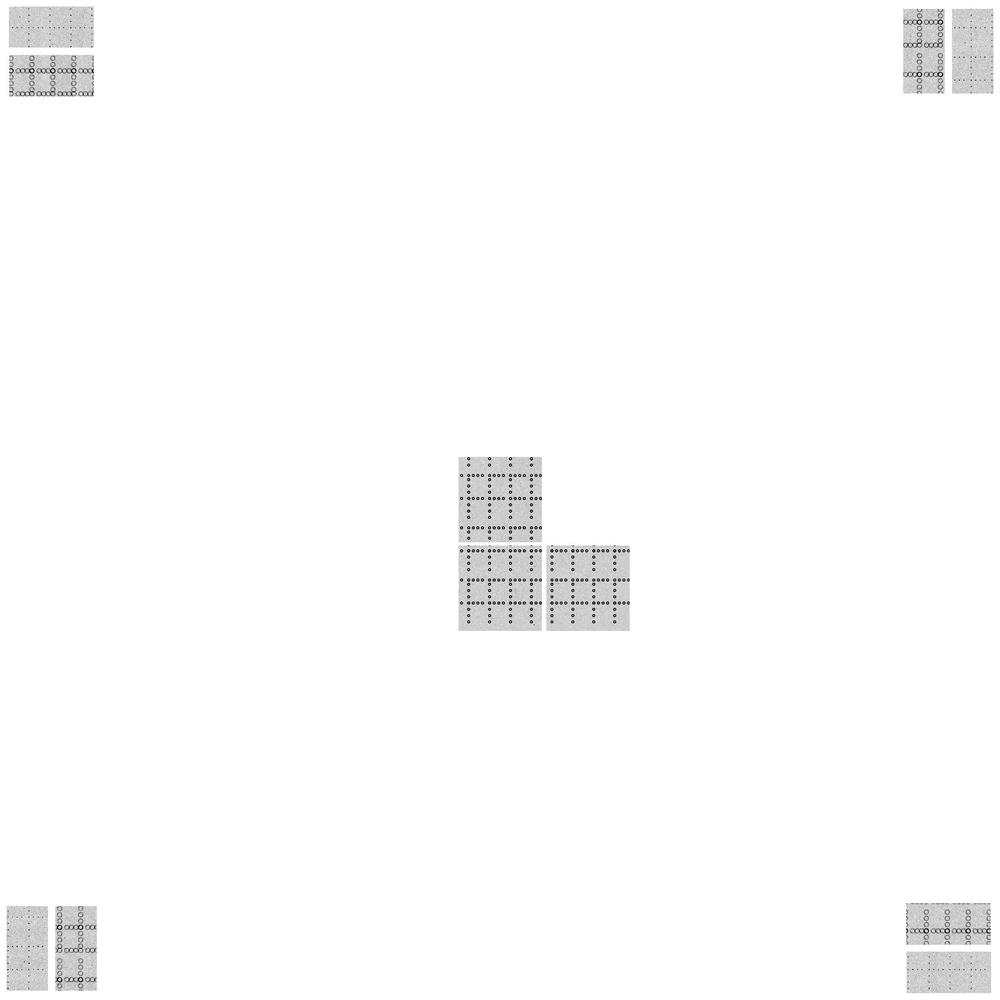

In [70]:
fig,ax = plt.subplots(1,1,figsize=(45,45))
zscale = ZScaleInterval()
vmin, vmax = zscale.get_limits(mos.array)
ax.imshow(np.rot90(mos.array), cmap='Greys', vmin=vmin,vmax=vmax)
ax.axis("off")
plt.savefig("LsstCam_letter_entire_tiledF_wfs_hires.png",dpi=150)


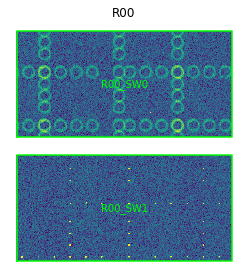

In [25]:


def plot_corner_rafts(repo_dir, instrument='LSSTCam'):

    afwDisplay.setDefaultBackend("matplotlib")

    # need to specify the calib collections to be able to access the camera 

    butler = dafButler.Butler(repo_dir, collections=[f'{instrument}/raw/all',
                                                     f'{instrument}/calib','run1',
                                                     f'{instrument}/calib/unbounded']
                             )

    dataId0 = dict(instrument=instrument)
    dataset = next(iter(
                        butler.registry.queryDatasets(
                            datasetType='postISRCCD', 
                            collections=['run1'],
                            dataId=dataId0  )
                        )
                   )

    exposure = dataset.dataId["exposure"]

    camera  = butler.get("camera", instrument=instrument, exposure=exposure)


    fig = plt.figure(figsize=(10,10))
    fig.subplots_adjust(hspace=0.2, wspace=0.0, )

    disp = afwDisplay.Display(fig)
    disp.scale('asinh', 'zscale', Q=2)

    disp.setImageColormap('viridis' if True else 'gray')
    dataType = "postISRCCD"

    detectorNameLists = [#['R40_SW0', 'R40_SW1'],
                     #     ['R44_SW0', 'R44_SW1'],
                          ['R00_SW0', 'R00_SW1'],
#                          ['R04_SW0', 'R04_SW1']
                        ]
    i = 1
    for detectorNameList in detectorNameLists:

        ax = fig.add_subplot(2, 2, i)

        raftName = detectorNameList[0][:3]
        mos = cameraGeomUtils.showCamera(camera,
                                     cameraGeomUtils.ButlerImage(butler, dataType, 
                                                                 instrument=instrument, 
                                                                 exposure=exposure,
                                                                 verbose=True),
                                     binSize=16, 
                                     detectorNameList=detectorNameList, 
                                     display=disp, overlay=True,
                                     title=raftName,)
        disp.show_colorbar(False)
        ax.axis("off")

        i += 1 
    return mos

        
mos = plot_corner_rafts('/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF/DATA/')

In [23]:
mos.array

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)

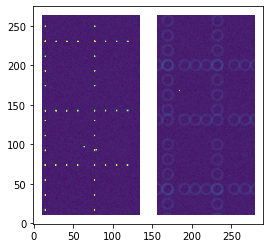

In [26]:
plt.imshow(mos.array.T,vmax=30,origin='lower')

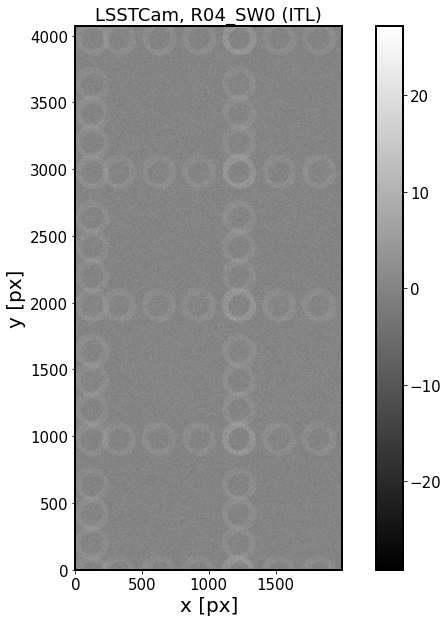

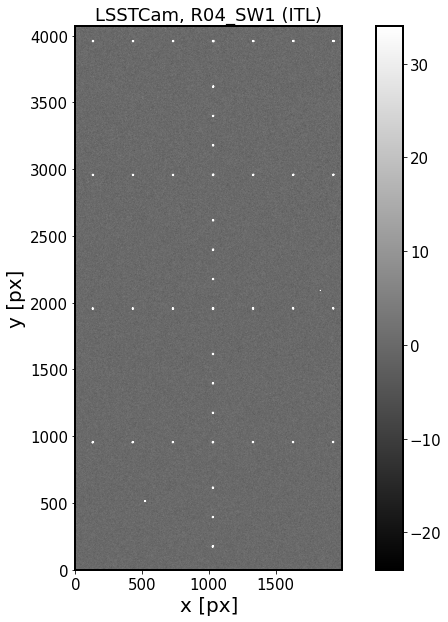

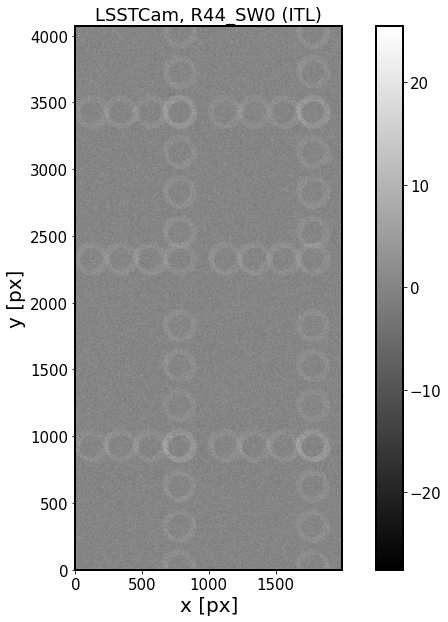

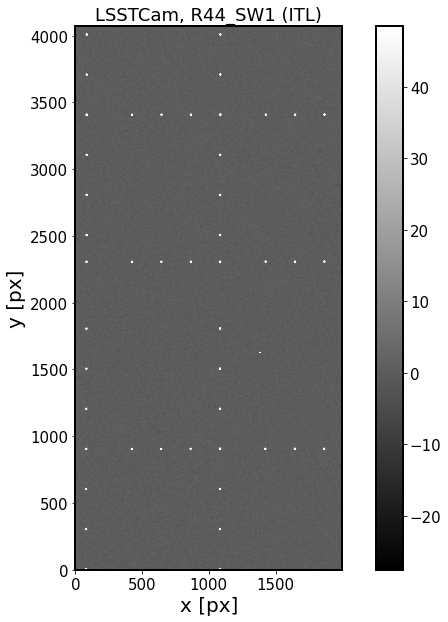

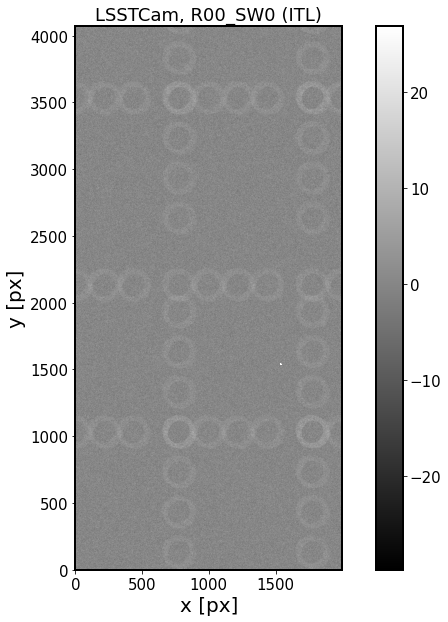

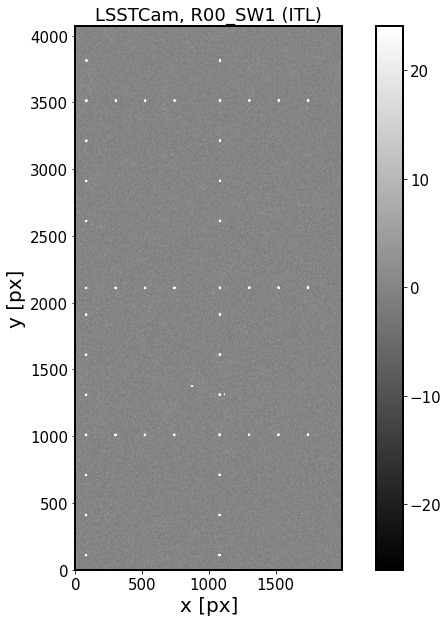

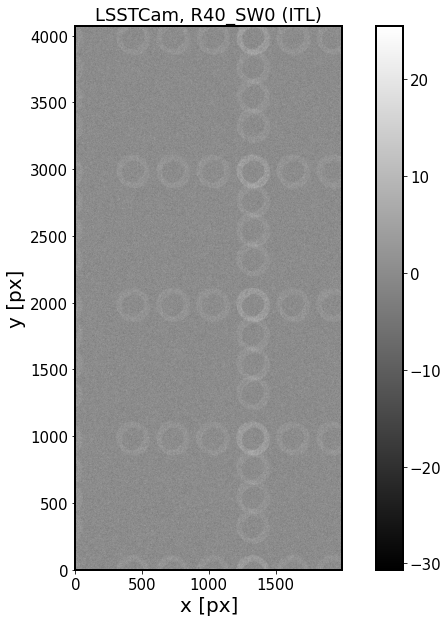

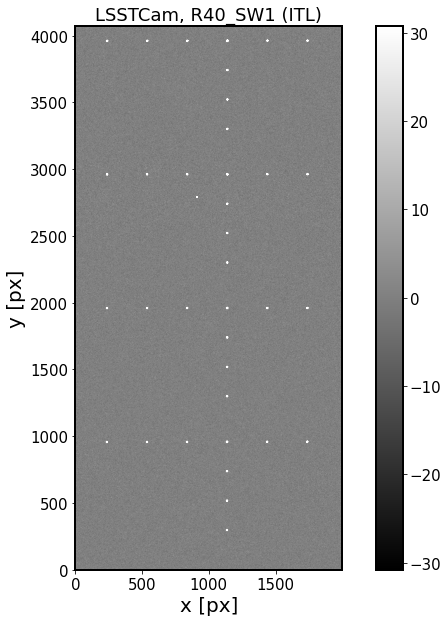

In [66]:
# show the raw image 
from lsst.daf import butler as dafButler
import matplotlib.pyplot as plt
from matplotlib import rcParams 
from astropy.io import fits
from astropy.visualization import ZScaleInterval
zscale = ZScaleInterval()

instrument = 'LSSTCam'
repo_dir = '/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF/DATA/'
butler = dafButler.Butler(repo_dir, collections=[f'{instrument}/raw/all',
                                                 f'{instrument}/calib','run1',
                                                 f'{instrument}/calib/unbounded'],
                             )
        
dataId0 = dict(instrument=instrument)
dataset = next(iter(butler.registry.queryDatasets(
                    datasetType='raw',
                    dataId=dataId0  )))

expN = dataset.dataId["exposure"]
for detector in ["R04_SW0", "R04_SW1",
                     "R44_SW0", "R44_SW1",
                     "R00_SW0", "R00_SW1",
                     "R40_SW0", "R40_SW1" ]:
    exposure = butler.get('postISRCCD', detector=detector, 
                          instrument=instrument,exposure=expN,
              collections=['run1'])
    detector  = exposure.getDetector()
    data = exposure.image.array

    vmin, vmax = zscale.get_limits(data)

    fig = plt.figure(figsize=(12, 10))
    plt.imshow(
        data.T, origin='lower', vmin=vmin,vmax=vmax,cmap='gray')
    plt.colorbar()
    plt.xlabel('x [px]')
    plt.ylabel('y [px]')
    detectorName, detectorType = detector.getName(), detector.getSerial()[:3] 
    plt.title(f'{instrument}, {detectorName} ({detectorType})')
    plt.savefig(f'{instrument}_entire_tiledF_{detectorName}_{detectorType}.png', bbox_inches='tight')

Change the Euler rotation for the corner sensors - would that help?

1) changed only R04_SW0 by +90 : 
   
    # on LSP
    python update_focalplanelayout_lsst.py   # with update_euler = True , using only the dictionary to update specific sensors 
    cd /project/scichris/aos/phosim_syseng4/data/lsst/
    cp focalplanelayout_DM-30367.txt focalplanelayout.txt


    # on NCSA
    cd /project/scichris/aos/images/lsstCam
    mkdir letter_lsstCam_entire_tiledF_R04_SW0_rot90
    mkdir letter_lsstCam_entire_tiledF_R04_SW0_rot90/raw
    cd letter_lsstCam_entire_tiledF_R04_SW0_rot90
    
    
    
    python /project/scichris/aos/phosim_syseng4/phosim.py /project/scichris/aos/images/lsstCam/lsstCam_entire_tiledF_.inst -i lsst -e 1 -c /project/scichris/aos/images/lsstCam/noBkgnd.cmd -p 25 -s R04_SW0 -o /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_R04_SW0_rot90/raw/ > starPhoSimLetter.log 2>&1



    phosim_repackager.py /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_R04_SW0_rot90/raw/ --out_dir /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_R04_SW0_rot90/repackaged/ --inst lsst 


    cp ../letter_R22/runIsr.sh .
    cp ../letter_R22/testPipeline.yaml .

    ./runIsr.sh               

**NOTE** 

butler `plt.imshow(data.array.T , origin='lower')` is in CCS   (ra,dec aligned with x,y )

cameraGeom  `mos = cameraGeomUtils.showCamera` is in DVCS 

cameraGeom  `plt.imshow(np.rot90(mos))` is in CCS 



Thus I would expect things to be upright if plotted that way in butler  

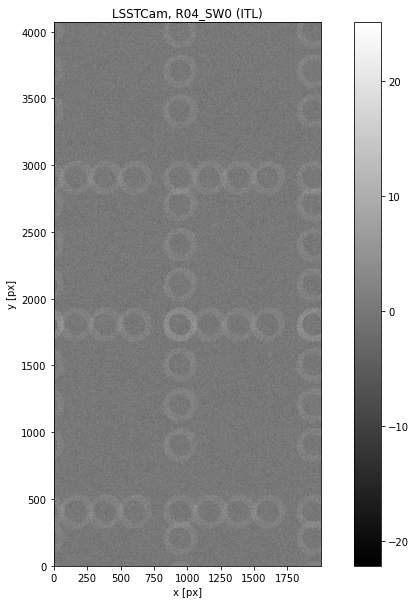

In [1]:
# show the raw image 
from lsst.daf import butler as dafButler
import matplotlib.pyplot as plt
from matplotlib import rcParams 
from astropy.io import fits
from astropy.visualization import ZScaleInterval
zscale = ZScaleInterval()

instrument = 'LSSTCam'
repo_dir = '/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_R04_SW0_rot90/DATA/'
butler = dafButler.Butler(repo_dir, collections=[f'{instrument}/raw/all',
                                                 f'{instrument}/calib','run1',
                                                 f'{instrument}/calib/unbounded'],
                             )
        
dataId0 = dict(instrument=instrument)
dataset = next(iter(butler.registry.queryDatasets(
                    datasetType='raw',
                    dataId=dataId0  )))

expN = dataset.dataId["exposure"]

detector = "R04_SW0"
# for detector in ["R04_SW0", "R04_SW1",
#                      "R44_SW0", "R44_SW1",
#                      "R00_SW0", "R00_SW1",
#                      "R40_SW0", "R40_SW1" ]:
exposure = butler.get('postISRCCD', detector=detector, 
                      instrument=instrument,exposure=expN,
          collections=['run1'])
detector  = exposure.getDetector()
data = exposure.image.array

vmin, vmax = zscale.get_limits(data)

fig = plt.figure(figsize=(12, 10))
plt.imshow(
    data.T, origin='lower', vmin=vmin,vmax=vmax,cmap='gray')
plt.colorbar()
plt.xlabel('x [px]')
plt.ylabel('y [px]')
detectorName, detectorType = detector.getName(), detector.getSerial()[:3] 
plt.title(f'{instrument}, {detectorName} ({detectorType})')
plt.savefig(f'{instrument}_entire_tiledF_{detectorName}_{detectorType}_only_rot90.png', bbox_inches='tight')

2)changed  R04_SW0 by +90  and R04_SW1 by +90:     

    cd /project/scichris/aos/images/lsstCam
    mkdir letter_lsstCam_entire_tiledF_R04_SW0_SW1_rot90
    mkdir letter_lsstCam_entire_tiledF_R04_SW0_SW1_rot90/raw
    cd letter_lsstCam_entire_tiledF_R04_SW0_SW1_rot90
    
    
    
    python /project/scichris/aos/phosim_syseng4/phosim.py /project/scichris/aos/images/lsstCam/lsstCam_entire_tiledF_.inst -i lsst -e 1 -c /project/scichris/aos/images/lsstCam/noBkgnd.cmd -p 25 -s "R04_SW0|R04_SW1" -o /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_R04_SW0_SW1_rot90/raw/ > starPhoSimLetter.log 2>&1



    phosim_repackager.py /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_R04_SW0_SW1_rot90/raw/ --out_dir /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_R04_SW0_SW1_rot90/repackaged/ --inst lsst 


    cp ../letter_R22/runIsr.sh .
    cp ../letter_R22/testPipeline.yaml .

    ./runIsr.sh               

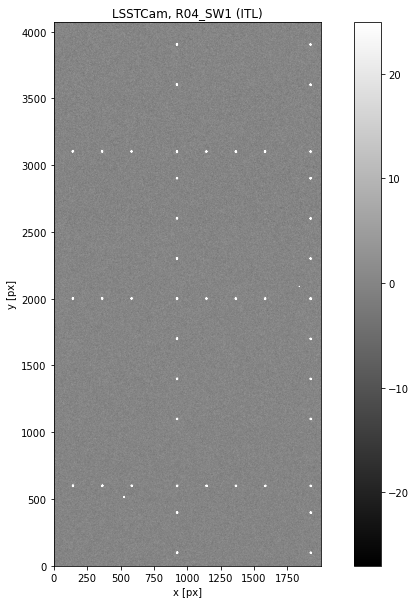

In [2]:
# show the raw image 
from lsst.daf import butler as dafButler
import matplotlib.pyplot as plt
from matplotlib import rcParams 
from astropy.io import fits
from astropy.visualization import ZScaleInterval
zscale = ZScaleInterval()

instrument = 'LSSTCam'
repo_dir = '/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_R04_SW0_SW1_rot90/DATA/'
butler = dafButler.Butler(repo_dir, collections=[f'{instrument}/raw/all',
                                                 f'{instrument}/calib','run1',
                                                 f'{instrument}/calib/unbounded'],
                             )
        
dataId0 = dict(instrument=instrument)
dataset = next(iter(butler.registry.queryDatasets(
                    datasetType='raw',
                    dataId=dataId0  )))

expN = dataset.dataId["exposure"]

detector = "R04_SW1"
# for detector in ["R04_SW0", "R04_SW1",
#                      "R44_SW0", "R44_SW1",
#                      "R00_SW0", "R00_SW1",
#                      "R40_SW0", "R40_SW1" ]:
exposure = butler.get('postISRCCD', detector=detector, 
                      instrument=instrument,exposure=expN,
          collections=['run1'])
detector  = exposure.getDetector()
data = exposure.image.array


vmin, vmax = zscale.get_limits(data)

fig = plt.figure(figsize=(12, 10))
plt.imshow(
    data.T, origin='lower', vmin=vmin,vmax=vmax,cmap='gray')
plt.colorbar()
plt.xlabel('x [px]')
plt.ylabel('y [px]')
detectorName, detectorType = detector.getName(), detector.getSerial()[:3] 
plt.title(f'{instrument}, {detectorName} ({detectorType})')
plt.savefig(f'{instrument}_entire_tiledF_{detectorName}_{detectorType}_only_rot90.png', bbox_inches='tight')

show that with cameraGeom:

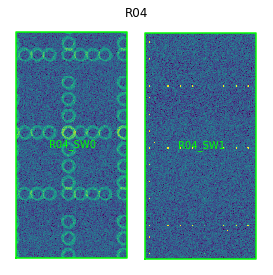

In [27]:
import os
# show the raw image 
from lsst.daf import butler as dafButler
import lsst.afw.cameraGeom.utils as cameraGeomUtils
import lsst.afw.display as afwDisplay

import matplotlib.pyplot as plt
from matplotlib import rcParams 
from astropy.io import fits
from astropy.visualization import ZScaleInterval

afwDisplay.setDefaultBackend("matplotlib")

def plot_corner_rafts(repo_dir, instrument='LSSTCam',
                      detectorNameLists = [['R04_SW0', 'R04_SW1'],
                        ]):

    afwDisplay.setDefaultBackend("matplotlib")

    # need to specify the calib collections to be able to access the camera 

    butler = dafButler.Butler(repo_dir, collections=[f'{instrument}/raw/all',
                                                     f'{instrument}/calib','run1',
                                                     f'{instrument}/calib/unbounded']
                             )

    dataId0 = dict(instrument=instrument)
    dataset = next(iter(
                        butler.registry.queryDatasets(
                            datasetType='postISRCCD', 
                            collections=['run1'],
                            dataId=dataId0  )
                        )
                   )

    exposure = dataset.dataId["exposure"]

    camera  = butler.get("camera", instrument=instrument, exposure=exposure)


    fig = plt.figure(figsize=(10,10))
    fig.subplots_adjust(hspace=0.2, wspace=0.0, )

    disp = afwDisplay.Display(fig)
    disp.scale('asinh', 'zscale', Q=2)

    disp.setImageColormap('viridis' if True else 'gray')
    dataType = "postISRCCD"

    
    i = 1
    for detectorNameList in detectorNameLists:

        ax = fig.add_subplot(2, 2, i)

        raftName = detectorNameList[0][:3]
        mos = cameraGeomUtils.showCamera(camera,
                                     cameraGeomUtils.ButlerImage(butler, dataType, 
                                                                 instrument=instrument, 
                                                                 exposure=exposure,
                                                                 verbose=True),
                                     binSize=16, 
                                     detectorNameList=detectorNameList, 
                                     display=disp, overlay=True,
                                     title=raftName,)
        disp.show_colorbar(False)
        ax.axis("off")

        i += 1 
    return mos

        
mos = plot_corner_rafts('/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_R04_SW0_SW1_rot90/DATA/')

In [11]:
mos.array

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], dtype=float32)

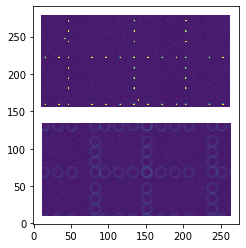

In [16]:
import numpy as np
plt.imshow(mos.array.T,vmax=30, origin='lower')

3) changed  R04_SW0, R00_SW0, R40_SW0, R44_SW0 by +180  and kept SW1 unchanged   

    nano lsstCam_entire_tiledF_.inst # comment out or remove the defocal "move" command 
 
    cd /project/scichris/aos/images/lsstCam
    mkdir letter_lsstCam_entire_tiledF_all_SW0_rot180
    mkdir letter_lsstCam_entire_tiledF_all_SW0_rot180/raw
    cd letter_lsstCam_entire_tiledF_all_SW0_rot180
    
    
    
    python /project/scichris/aos/phosim_syseng4/phosim.py /project/scichris/aos/images/lsstCam/lsstCam_entire_tiledF_.inst -i lsst -e 1 -c /project/scichris/aos/images/lsstCam/noBkgnd.cmd -p 25 -s "R04_SW0|R04_SW1|R40_SW0|R40_SW1|R44_SW0|R44_SW1|R00_SW0|R00_SW1" -o /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_all_SW0_rot180/raw/ > starPhoSimLetter.log 2>&1



    phosim_repackager.py /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_all_SW0_rot180/raw/ --out_dir /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_all_SW0_rot180/repackaged/ --inst lsst 


    cp ../letter_R22/runIsr.sh .
    cp ../letter_R22/testPipeline.yaml .

    ./runIsr.sh               

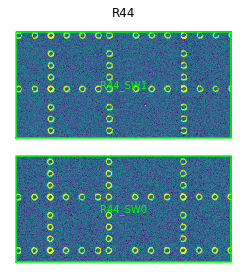

In [37]:
mos = plot_corner_rafts(repo_dir='/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_all_SW0_rot180/DATA/', 
                  instrument='LSSTCam',
                  detectorNameLists = [['R44_SW0', 'R44_SW1'],]
                 )

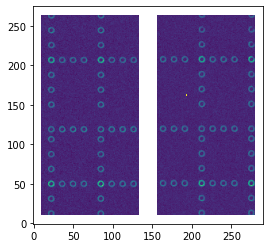

In [38]:
plt.imshow(mos.array.T,origin='lower',vmax=20
          )

In [20]:
import os
# show the raw image 
from lsst.daf import butler as dafButler
import lsst.afw.cameraGeom.utils as cameraGeomUtils
import lsst.afw.display as afwDisplay

import matplotlib.pyplot as plt
from matplotlib import rcParams 
from astropy.io import fits
from astropy.visualization import ZScaleInterval


def plot_cameraGeom(repo_dir = os.path.join('/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF/DATA/'),
                   detectorNameList = [ "R04_SW0", "R04_SW1",
                         "R44_SW0", "R44_SW1",
                         "R00_SW0", "R00_SW1",
                         "R40_SW0", "R40_SW1",
                      
                       ] ,
                   ):
    afwDisplay.setDefaultBackend("matplotlib")

    #repo_dir = os.path.join('/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF/DATA/')

    # need to specify the calib collections to be able to access the camera 
    instrument = 'LSSTCam'
    butler = dafButler.Butler(repo_dir, collections=[f'{instrument}/raw/all',
                                                     f'{instrument}/calib','run1',
                                                     f'{instrument}/calib/unbounded']
                             )

    dataId0 = dict(instrument=instrument)
    dataset = next(iter(
                        butler.registry.queryDatasets(
                            datasetType='postISRCCD', 
                            collections=['run1'],
                            dataId=dataId0  )
                        )
                   )

    exposure = dataset.dataId["exposure"]

    camera  = butler.get("camera", instrument=instrument, exposure=exposure)

    fig = plt.figure(figsize=(15,15))
    fig.subplots_adjust(hspace=0., wspace=0.0, )

    ax = fig.add_subplot(1, 1, 1)

    disp = afwDisplay.Display(fig)
    disp.scale('asinh', 'zscale', Q=2)
    #disp.scale('linear', 'minmax')
    #disp.scale('asinh', 5, 7000, Q=2)

    disp.setImageColormap('viridis' if True else 'gray')
    dataType = "postISRCCD"


    # use that  to limit what's shown
    #detectorNameList = ['R22_S11', 'R22_S20', 'R22_S10']# , 'R34_S20'] 

    # set to None to plot everything
    
    mos = cameraGeomUtils.showCamera(camera,
                                 cameraGeomUtils.ButlerImage(butler, dataType, 
                                                             instrument=instrument, 
                                                             exposure=exposure,
                                                             verbose=True),
                                 binSize=16, 
                                 detectorNameList=detectorNameList, 
                                 display=disp, overlay=True, title=f'{instrument}' )

    disp.show_colorbar(False)
    ax.axis("off")

    #plt.savefig('LsstCam_letter_entire_tiledF_wfs.png', bbox_inches='tight')
    return mos




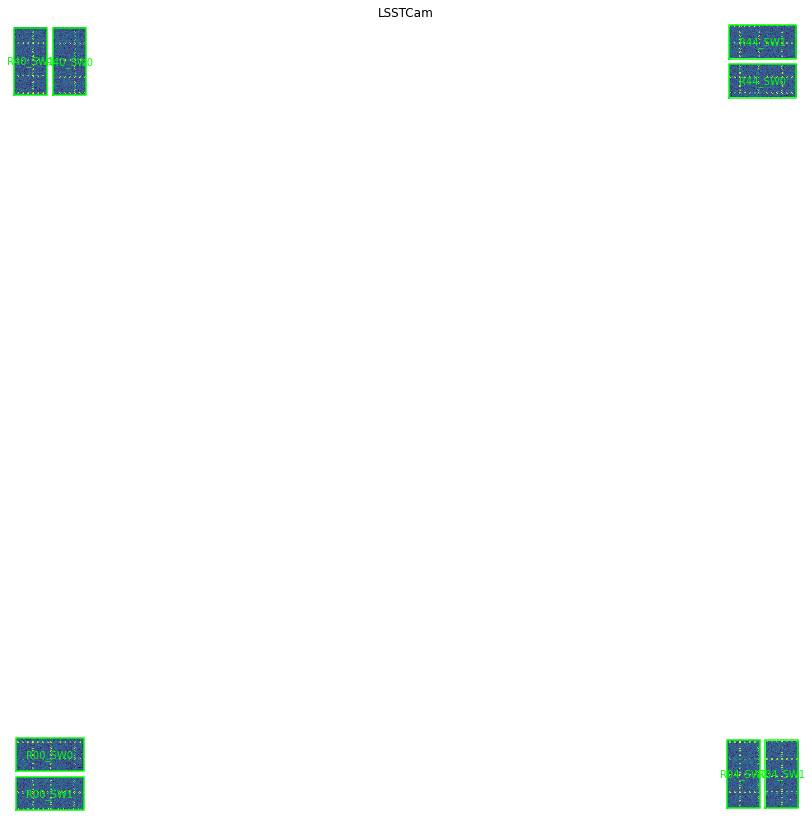

In [42]:
mos = plot_cameraGeom(repo_dir = 
                '/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_all_SW0_rot180/DATA/',
               )

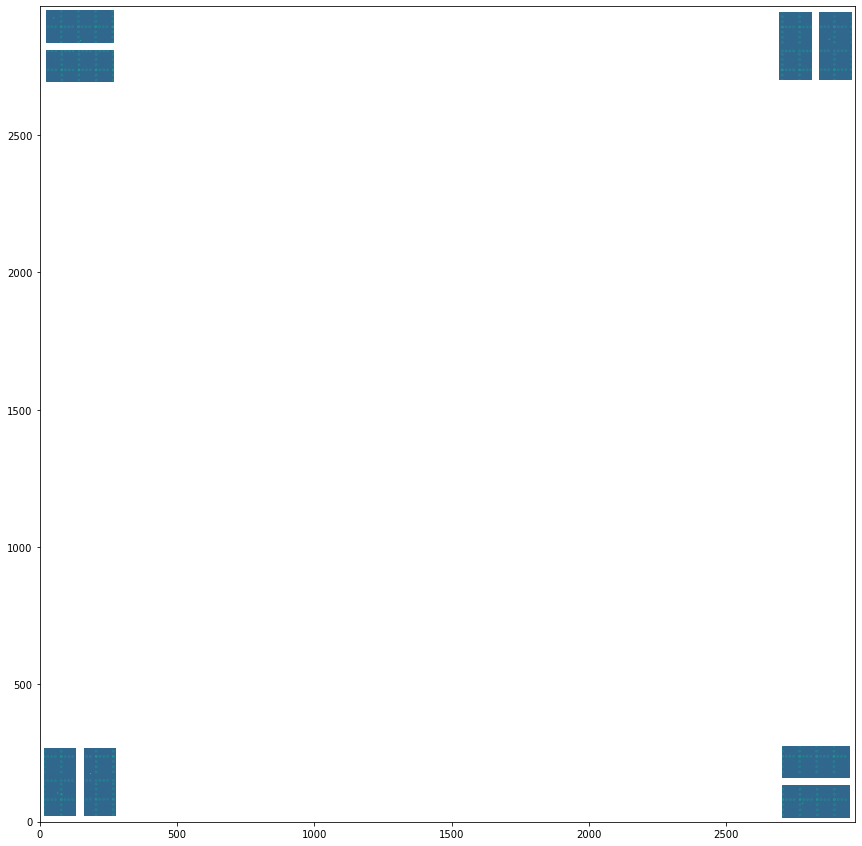

In [52]:
fig,ax = plt.subplots(1,1,figsize=(15,15))
ax.imshow(mos.array.T, origin='lower', vmax=20,vmin=-10)

4) changed  R04_SW0, R00_SW0, R40_SW0, R44_SW0 by +180  and kept SW1 unchanged    - simulate the entire focal plane 

    nano lsstCam_entire_tiledF_.inst # comment out or remove the defocal "move" command 
 
    cd /project/scichris/aos/images/lsstCam
    mkdir letter_lsstCam_entire_tiledF_all_rot
    mkdir letter_lsstCam_entire_tiledF_all_rot/raw
    cd letter_lsstCam_entire_tiledF_all_rot
    
    
    
    python /project/scichris/aos/phosim_syseng4/phosim.py /project/scichris/aos/images/lsstCam/lsstCam_entire_tiledF_.inst -i lsst -e 1 -c /project/scichris/aos/images/lsstCam/noBkgnd.cmd -p 25  -o /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_all_rot/raw/ > starPhoSimLetter.log 2>&1


    phosim_repackager.py /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_all_rot/raw/ --out_dir /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_all_rot/repackaged/ --inst lsst 


    cp ../letter_R22/runIsr.sh .
    cp ../letter_R22/testPipeline.yaml .

    ./runIsr.sh               

Reading 189: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 189, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 190: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 190, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 193: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 193, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 194: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 194, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 197: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 197, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam

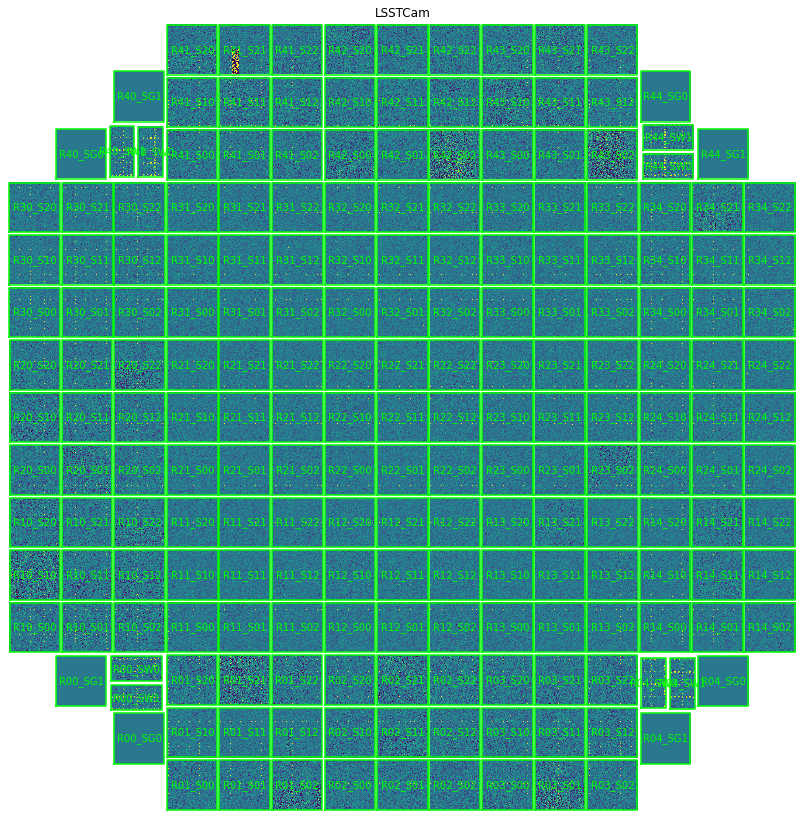

In [54]:
mos = plot_cameraGeom(repo_dir = 
                '/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiledF_all_rot/DATA/',
                      detectorNameList=None
               )

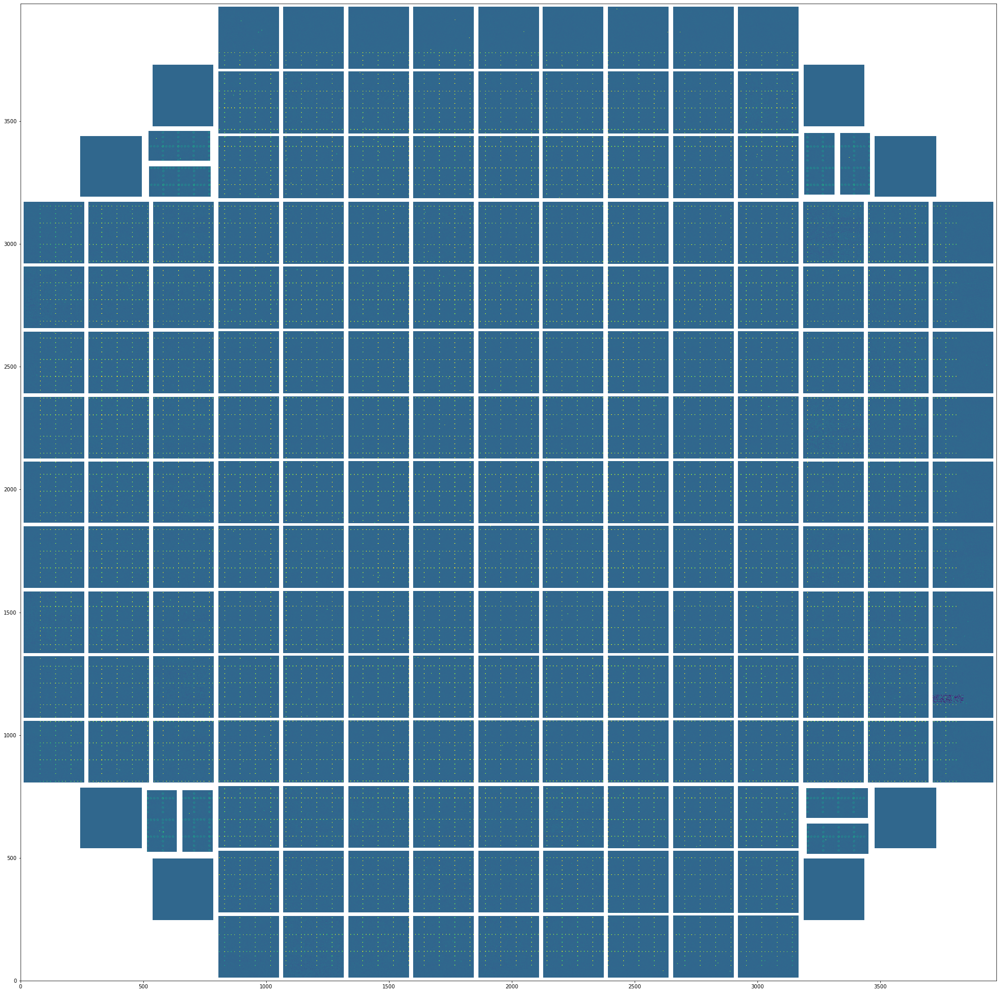

In [57]:
fig,ax = plt.subplots(1,1,figsize=(35,35))
ax.imshow(mos.array.T, origin='lower', vmax=20,vmin=-10)
plt.savefig('letter_lsstCam_entire_tiledF_all_rot.pdf', bbox_inches='tight', dpi=150)

    cd /project/scichris/aos/images/lsstCam
    mkdir letter_lsstCam_entire_tiled_LSST_all_rot
    mkdir letter_lsstCam_entire_tiled_LSST_all_rot/raw
    cd letter_lsstCam_entire_tiled_LSST_all_rot
    
    
    
    python /project/scichris/aos/phosim_syseng4/phosim.py /project/scichris/aos/images/lsstCam/lsstCam_entire_tiled_LSST.inst -i lsst -e 1 -c /project/scichris/aos/images/lsstCam/noBkgnd.cmd -p 25  -o /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiled_LSST_all_rot/raw/ > starPhoSimLetter.log 2>&1


    phosim_repackager.py /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiled_LSST_all_rot/raw/ --out_dir /project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiled_LSST_all_rot/repackaged/ --inst lsst 


    cp ../letter_R22/runIsr.sh .
    cp ../letter_R22/testPipeline.yaml .

    ./runIsr.sh               
    
    
    /project/scichris/aos/images/lsstCam/lsstCam_entire_tiled_LSST.inst

Reading 189: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 189, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 190: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 190, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 193: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 193, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 194: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 194, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam/calib, run1, LSSTCam/calib/unbounded].
Reading 197: Dataset postISRCCD with data ID {instrument: 'LSSTCam', detector: 197, exposure: 4016091606002} could not be found in collections [LSSTCam/raw/all, LSSTCam

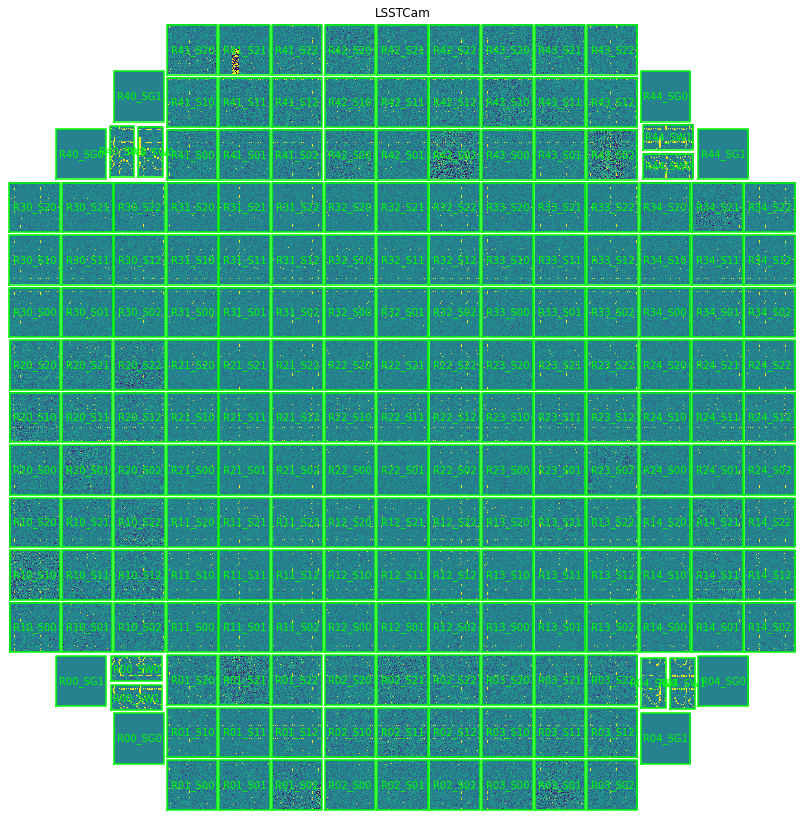

In [2]:
mos = plot_cameraGeom(repo_dir = 
                '/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiled_LSST_all_rot/DATA/',
                      detectorNameList=None
               )

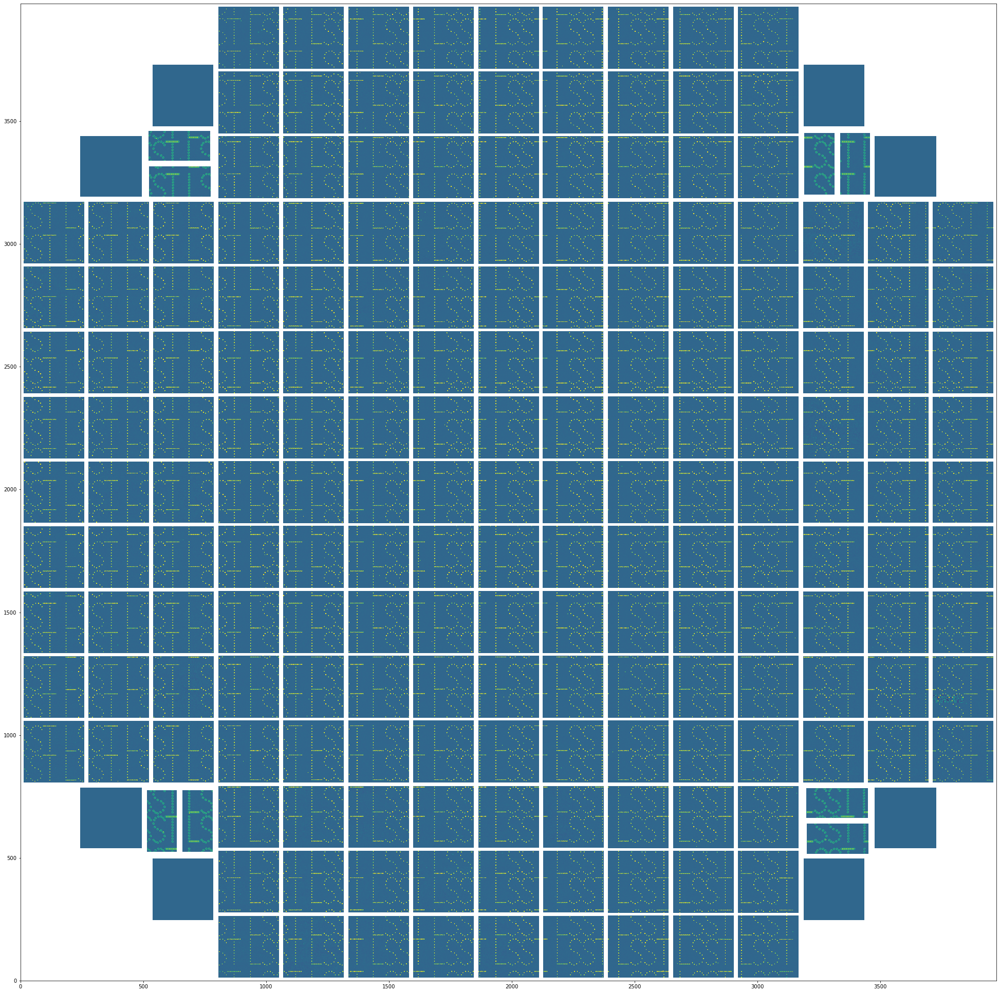

In [3]:
fig,ax = plt.subplots(1,1,figsize=(35,35))
ax.imshow(mos.array.T, origin='lower', vmax=20, vmin=-10)
plt.savefig('letter_lsstCam_entire_tiled_LSST_all_rot.pdf', bbox_inches='tight', dpi=150)

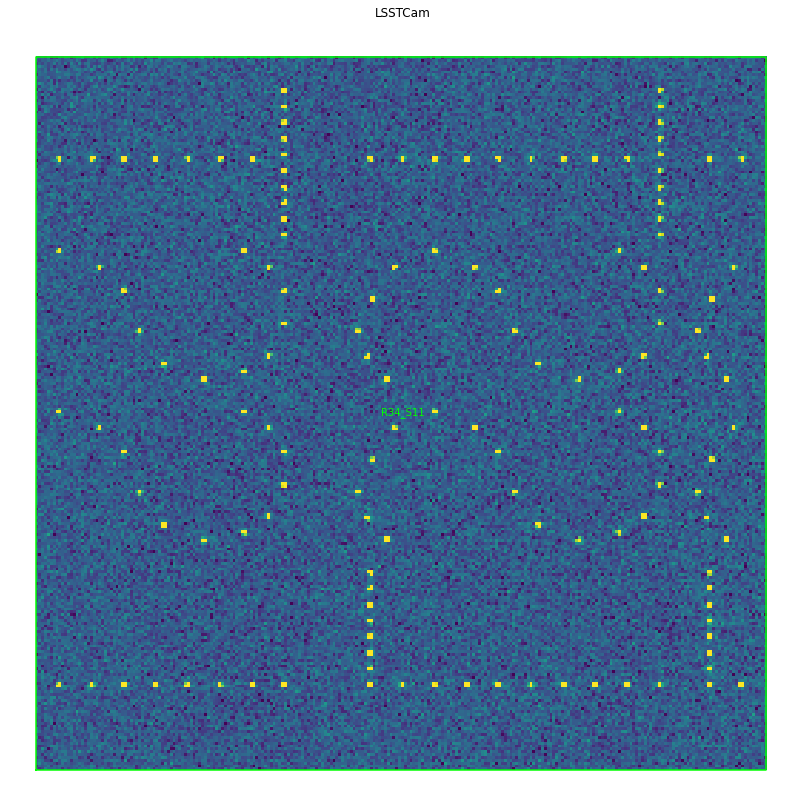

In [21]:
mos = plot_cameraGeom(repo_dir = 
                '/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiled_LSST_all_rot/DATA/',
                      detectorNameList=['R34_S11']
               )

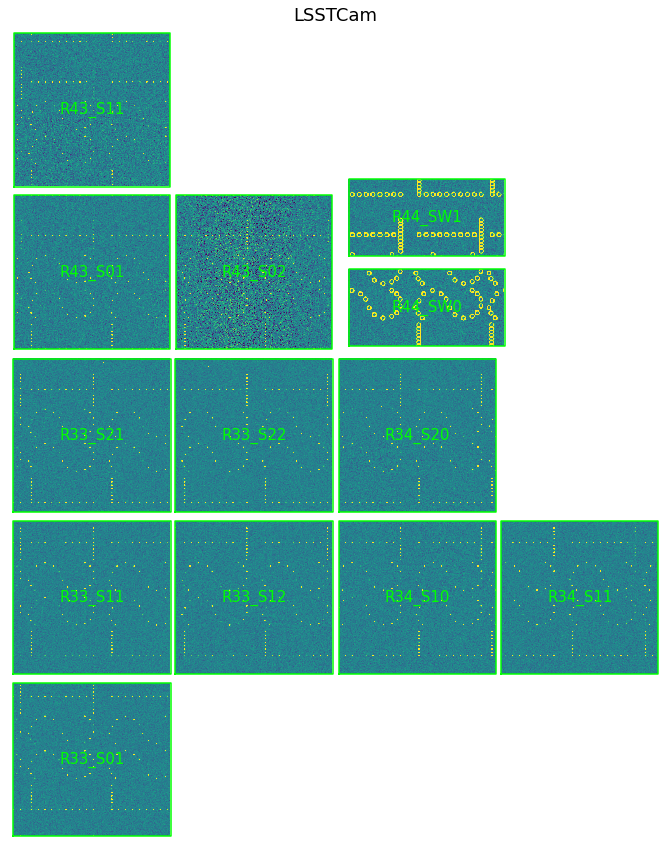

In [63]:
mos = plot_cameraGeom(repo_dir = 
                '/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiled_LSST_all_rot/DATA/',
                      detectorNameList=['R34_S11','R34_S10','R34_S20',
                                        'R33_S12','R33_S11','R33_S21','R33_S01','R33_S22',
                                       'R43_S01','R43_S11', 'R43_S02', 'R44_SW0', 'R44_SW1']
               )

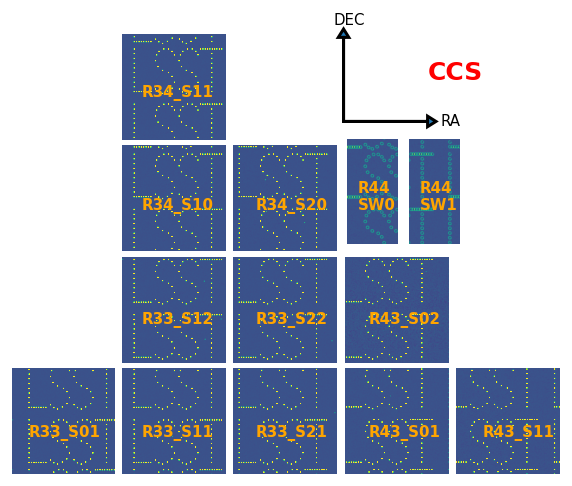

In [113]:
from matplotlib import rcParams 
rcParams['ytick.labelsize'] = 15
rcParams['xtick.labelsize'] = 15
rcParams['axes.labelsize'] = 20
rcParams['axes.linewidth'] = 2
rcParams['font.size'] = 15
rcParams['axes.titlesize'] = 18

import matplotlib.patheffects as path_effects

fig,ax = plt.subplots(1,1,figsize=(10,10))
ax.imshow(mos.array.T, origin='lower',vmin=-10,vmax=30)
ax.set_xlabel('x px (CCS)')
ax.set_ylabel('y px  (CCS)')
yt = 100
x0 = 50
dx = 270
dy = 270
ct = 'orange'
fw = 'bold'
ax.text(x0,yt,'R33_S01',c=ct , fontweight=fw)#path_effects=[path_effects.Stroke(linewidth=1, foreground='yellow')])
ax.text(x0+dx,yt,'R33_S11',c=ct, fontweight=fw)
ax.text(x0+2*dx,yt,'R33_S21',c=ct,fontweight=fw)
ax.text(x0+3*dx,yt,'R43_S01',c=ct ,fontweight=fw)
ax.text(x0+4*dx,yt,'R43_S11',c=ct ,fontweight=fw)


ax.text(x0+dx, yt+dy, 'R33_S12',c=ct ,fontweight=fw)
ax.text(x0+dx, yt+2*dy, 'R34_S10',c=ct ,fontweight=fw)
ax.text(x0+dx, yt+3*dy, 'R34_S11',c=ct ,fontweight=fw)

ax.text(x0+2*dx,yt+dy, 'R33_S22',c=ct,fontweight=fw)
ax.text(x0+3*dx,yt+dy, 'R43_S02',c=ct,fontweight=fw)

ax.text(x0+2*dx,yt+2*dy, 'R34_S20',c=ct,fontweight=fw)

ax.text(x0+2.9*dx,yt+2*dy, 'R44\nSW0', c=ct,fontweight=fw)
ax.text(x0+3.45*dx,yt+2*dy, 'R44\nSW1', c=ct,fontweight=fw)


xstart,ystart, width, height = 800,850, 200,200
ax.arrow(xstart,ystart,width,0, head_width=25, head_length=20 ,lw=3)
ax.arrow(xstart,ystart,0,height, head_width=25, head_length=20 ,lw=3)
ax.text(xstart+width+30,ystart-10, 'RA')
ax.text(xstart-25, ystart+height+30, 'DEC')

ax.text(xstart+width, ystart+height/2., 'CCS', fontweight='extra bold', 
        fontsize=25, c='red')
ax.axis("off")

plt.savefig('letter_lsstCam_entire_tiled_LSST_all_rot.jpg', bbox_inches='tight', dpi=150)

Now test the WCS information (just like before) . Use `imshow(data.array.T, origin='lower')` to arrive at the CCS coordinate system .  

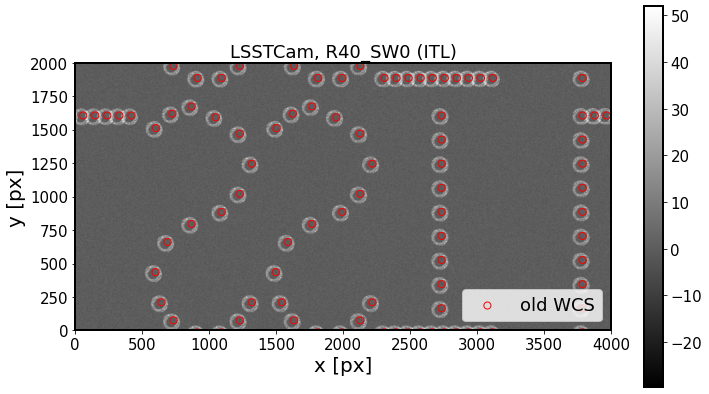

In [125]:
# show the raw image 
from lsst.daf import butler as dafButler
import matplotlib.pyplot as plt
from matplotlib import rcParams 
from astropy.io import fits
import numpy as np 
import pandas as pd
from astropy.visualization import ZScaleInterval
zscale = ZScaleInterval()

instrument = 'LSSTCam'
repo_dir = '/project/scichris/aos/images/lsstCam/letter_lsstCam_entire_tiled_LSST_all_rot/DATA/'
butler = dafButler.Butler(repo_dir, collections=[f'{instrument}/raw/all',
                                                 f'{instrument}/calib','run1',
                                                 f'{instrument}/calib/unbounded'],
                             )
        
dataId0 = dict(instrument=instrument)
dataset = next(iter(butler.registry.queryDatasets(
                    datasetType='raw',
                    dataId=dataId0  )))

expN = dataset.dataId["exposure"]

exposure = butler.get('postISRCCD', detector='R40_SW0', 
                      instrument=instrument,exposure=expN,
          collections=['run1'])
detector  = exposure.getDetector()
data = exposure.image.array

vmin, vmax = zscale.get_limits(data)

fig = plt.figure(figsize=(12, 7))
plt.imshow(data, origin='lower', vmin=vmin,vmax=vmax,cmap='gray')
plt.colorbar()
plt.xlabel('x [px]')
plt.ylabel('y [px]')

plt.title(f'{instrument}, {detector.getName()} ({detector.getSerial()[:3]})')


# read in the input instance catalog 
cat = np.genfromtxt('/project/scichris/aos/images/lsstCam/lsstCam_entire_tiled_LSST.inst',
                        skip_header=16)

cat_df = pd.DataFrame(cat[:, 1:5], columns=['id', 'ra', 'dec', 'g'])


# get the wcs 
wcs = exposure.getWcs()

# calculate the position given the x,y 
x,y= wcs.skyToPixelArray(cat_df['ra'], cat_df['dec'],degrees=True)

# plot the OLD WCS
plt.scatter(x,y,  facecolors='none', edgecolors='r', marker='o', s=50, label='old WCS')


# make new WCS 
import lsst.geom
from lsst.afw.geom import makeSkyWcs,  makeCdMatrix
orientation = 180 * lsst.geom.degrees  # 
flipX = True 
scale =  0.2 * lsst.geom.arcseconds  # how many arcsec per pixel 
cdMatrix = makeCdMatrix(scale=scale, orientation=orientation, flipX=flipX)

# crval  - `lsst.geom.SpherePoint`  Desired reference sky position.
# crpix = lsst.geom.Point2D(100, 100) - pixel corresponding ot the origin 
# xPx, yPx = wcs.getPixelOrigin()
# crpix = lsst.geom.Point2D(yPx, xPx)
# crval = lsst.geom.SpherePoint(0.0*lsst.geom.degrees, 0.0*lsst.geom.degrees)
# newWcs = makeSkyWcs(crpix=crpix, crval=crval, cdMatrix=cdMatrix)

# # calculate the position  with new WCS given the x,y 
# x,y = newWcs.skyToPixelArray(cat_df['ra'], cat_df['dec'],degrees=True)

# # plot the new  WCS
# plt.scatter(x,y,  facecolors='none', edgecolors='g', marker='o', s=50, label='new WCS')
plt.xlim(0,4000)
plt.ylim(0,2000)
plt.legend(fontsize=18)
detectorName, detectorType = detector.getName(), detector.getSerial()[:3] 
plt.savefig(f'letter_lsstCam_entire_tiled_LSST_all_rot{detectorName}_{detectorType}.jpeg',
           bbox_inches='tight', dpi=150)

compare OPD before and after 

In [ ]:
1) before: get the OPD at the main rafts and the corner rafts 
    
    -- in fact I already have that, because that's what I used when doing the simulation 
    -- simulate again, just in case ...